In [111]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from torchvision.utils import save_image
from torchvision import utils as vutils
from torchvision.models.inception import inception_v3
from scipy.stats import entropy
from torchvision.datasets import ImageFolder
import zipfile
import io
from tqdm import tqdm

In [112]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [113]:
class Dataset(Dataset):
    def __init__(self, img_dir, transform1=None, transform2=None):
    
        self.img_dir = img_dir
        self.img_names = os.listdir(img_dir)
        
        self.transform1 = transform1
        self.transform2 = transform2
        
        self.imgs = []
        for img_name in self.img_names:
            img = Image.open(os.path.join(img_dir, img_name))
            
            if self.transform1 is not None:
                img = self.transform1(img)
                
            self.imgs.append(img)

    def __getitem__(self, index):
        img = self.imgs[index]
        
        if self.transform2 is not None:
            img = self.transform2(img)
        
        return img

    def __len__(self):
        return len(self.imgs)

In [114]:
# Random Vertical Flip
random_vertical_flip = transforms.RandomVerticalFlip(p=0.5)


# Random Affine Transformation
random_affine = transforms.RandomAffine(degrees=10, translate=(0.1, 0.1), scale=(0.9, 1.1), shear=10)

In [115]:
batch_size = 64

In [116]:
# First preprocessing of data
transform1 = transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64)
])

# Data augmentation and converting to tensors
random_transforms = [
    transforms.RandomRotation(degrees=15),
    random_vertical_flip,
    random_affine
]
transform2 = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomApply(random_transforms, p=0.3), 
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])



***Testloader

In [117]:
train_dataset = Dataset(
    img_dir='/kaggle/input/train/Train_data',
    transform1=transform1,
    transform2=transform2
)

train_loader = DataLoader(
    dataset=train_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=4
)


In [118]:

test_dataset = Dataset(
    img_dir='/kaggle/input/photos/photu',
    transform1=transform1,  # Assuming you have defined transform1 earlier
    transform2=transform2  # No transformations for test dataset
)

# Create the test loader
test_loader = DataLoader(
    dataset=test_dataset,
    batch_size=batch_size,
    shuffle=False,  # No need to shuffle test data
    num_workers=4
)


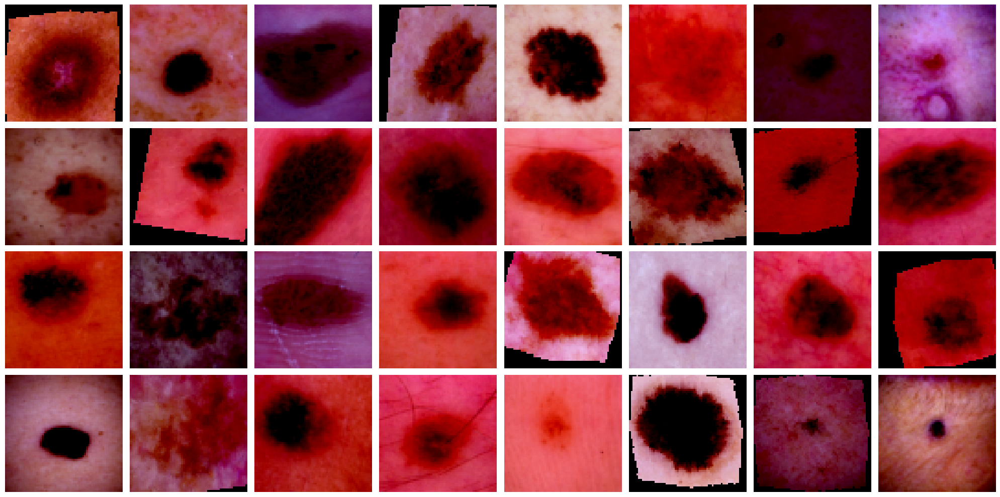

In [119]:
import matplotlib.pyplot as plt
import numpy as np

# Function to display images
def imshow(img):
    img = img / 2 + 0.5  # Unnormalize if normalization was applied
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')
    plt.show()

# Get a batch of images
images = next(iter(train_loader))

# Plot 32 images with 8 images per row
fig, axes = plt.subplots(4, 8, figsize=(20, 10))
for i in range(4):
    for j in range(8):
        idx = i * 8 + j
        ax = axes[i, j]
        ax.imshow(np.transpose(images[idx].numpy(), (1, 2, 0)))
        ax.axis('off')
plt.tight_layout()
plt.show()


In [120]:
class VQ(nn.Module):

    def __init__(self,num_embeddings=512,embedding_dim=64,commitment_cost=0.25):
        super().__init__()

        self.num_embeddings = num_embeddings
        self.embedding_dim = embedding_dim
        self.commitment_cost = commitment_cost

        self.embeddings = nn.Embedding(self.num_embeddings,self.embedding_dim)
        self.embeddings.weight.data.uniform_(-1/self.num_embeddings,1/self.num_embeddings)

    def forward(self,inputs):
        inputs = inputs.permute(0,2,3,1).contiguous()
        input_shape = inputs.shape

        flat_inputs = inputs.view(-1,self.embedding_dim)

        distances = torch.cdist(flat_inputs,self.embeddings.weight)
        encoding_index = torch.argmin(distances,dim=1)

        quantized = torch.index_select(self.embeddings.weight,0,encoding_index).view(input_shape)

        e_latent_loss = F.mse_loss(quantized.detach(),inputs)
        q_latent_loss = F.mse_loss(quantized,inputs.detach())
        c_loss = q_latent_loss + self.commitment_cost * e_latent_loss

        quantized = inputs + (quantized - inputs).detach()

        quantized = quantized.permute(0,3,1,2).contiguous()
        return c_loss, quantized

In [121]:
class ResudialBlock(nn.Module):
    def __init__(self,in_channels,out_channels,hidden_channels):
        super(ResudialBlock,self).__init__()
        self.resblock = nn.Sequential(nn.ReLU(inplace=True),
                                       nn.Conv2d(in_channels,hidden_channels,kernel_size=3,stride=1,padding=1,bias=False),
                                       nn.ReLU(inplace=True),
                                       nn.Conv2d(hidden_channels,out_channels,kernel_size=1,stride=1,bias=False))
    def forward(self,x):
        return x + self.resblock(x)

class ResudialStack(nn.Module):
    def __init__(self,in_channels,out_channels,hidden_channels,num_res_layers):
        super(ResudialStack,self).__init__()
        self.num_res_layers = num_res_layers
        self.layers = nn.ModuleList([ResudialBlock(in_channels,out_channels,hidden_channels) for _ in range(num_res_layers)])

    def forward(self,x):
        for i in range(self.num_res_layers):
            x = self.layers[i](x)
        return F.relu(x)

In [122]:
class Model(nn.Module):

    def __init__(self,num_embeddings=512,embedding_dim=64,commitment_cost=0.25):
        super().__init__()

        self.embedding_dim = embedding_dim
        self.num_embeddings = num_embeddings
        self.commitment_cost = commitment_cost

        #encode
        self.conv1 = nn.Conv2d(3,64,kernel_size=4,stride=2,padding=1)
        self.conv2 = nn.Conv2d(64,128,kernel_size=4,stride=2,padding=1)
        self.conv3 = nn.Conv2d(128,128,kernel_size=3,stride=1,padding=1)
        self.resblock1 = ResudialStack(128,128,64,3)

        #vq
        self.vq_conv = nn.Conv2d(128,self.embedding_dim,kernel_size=1,stride=1)
        self.vq = VQ(self.num_embeddings,self.embedding_dim,self.commitment_cost)

        #decode
        self.conv4 = nn.Conv2d(self.embedding_dim,64,kernel_size=3,stride=1,padding=1)
        self.resblock2 = ResudialStack(64,64,32,3)
        self.conv5 = nn.ConvTranspose2d(64,32,kernel_size=4,stride=2,padding=1)
        self.conv6 = nn.ConvTranspose2d(32,3,kernel_size=4,stride=2,padding=1)


    def encode(self,x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = self.conv3(x)
        x = self.resblock1(x)
        return x

    def decode(self,quantized):
        x = self.conv4(quantized)
        x = self.resblock2(x)
        x = F.relu(self.conv5(x))
        x = self.conv6(x)
        return x

    def forward(self,inputs):
        x = self.encode(inputs)
        c_loss,quantized =  self.vq(self.vq_conv(x))
        outputs = self.decode(quantized)
        rec_loss = F.mse_loss(outputs,inputs)
        loss = rec_loss + c_loss
        return loss,outputs,rec_loss

In [123]:
model = Model()
print(model)

Model(
  (conv1): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (resblock1): ResudialStack(
    (layers): ModuleList(
      (0-2): 3 x ResudialBlock(
        (resblock): Sequential(
          (0): ReLU(inplace=True)
          (1): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (2): ReLU(inplace=True)
          (3): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        )
      )
    )
  )
  (vq_conv): Conv2d(128, 64, kernel_size=(1, 1), stride=(1, 1))
  (vq): VQ(
    (embeddings): Embedding(512, 64)
  )
  (conv4): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (resblock2): ResudialStack(
    (layers): ModuleList(
      (0-2): 3 x ResudialBlock(
        (resblock): Sequential(
          (0): ReLU(inplace=True)
          (1): Conv2d(64

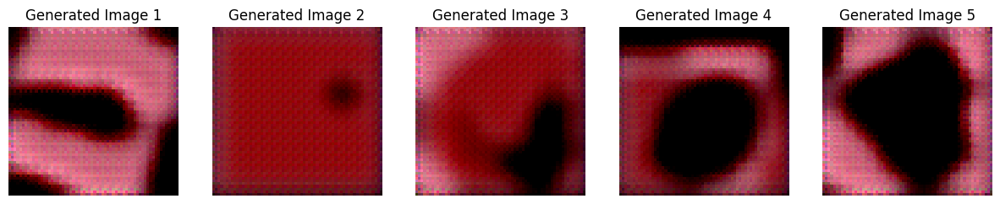

Epoch:0 | Train Loss:4.958108868378742 | Rec Loss:0.0712813287973404


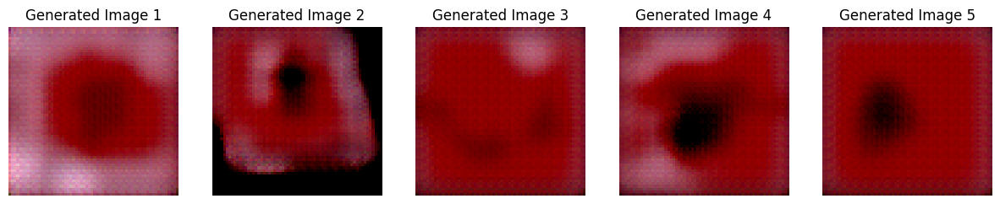

Epoch:1 | Train Loss:0.5430056247978833 | Rec Loss:0.025680117309093475


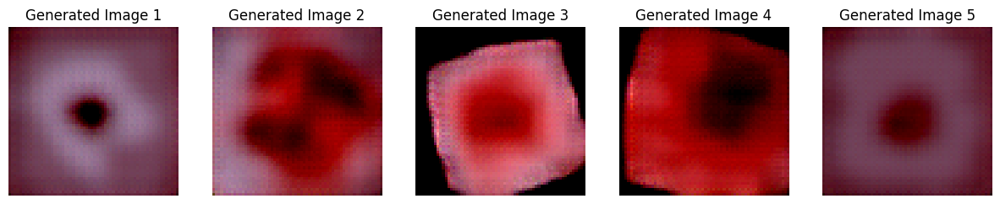

Epoch:2 | Train Loss:0.06471686779408697 | Rec Loss:0.016729887574911118


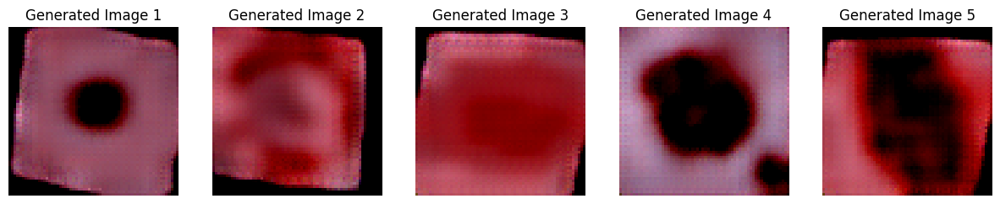

Epoch:3 | Train Loss:0.028869636487334396 | Rec Loss:0.01420682854950428


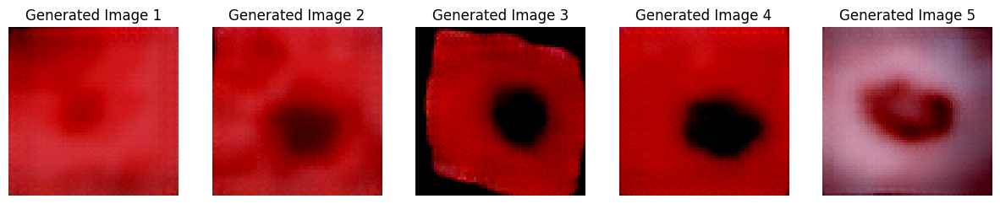

Epoch:4 | Train Loss:0.018509392294392083 | Rec Loss:0.010185951367020607


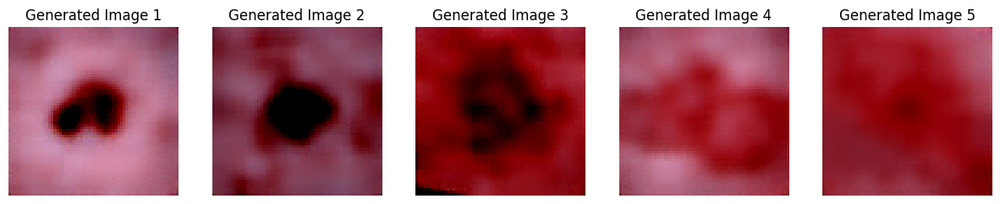

Epoch:5 | Train Loss:0.014148513994114414 | Rec Loss:0.009632592089474201


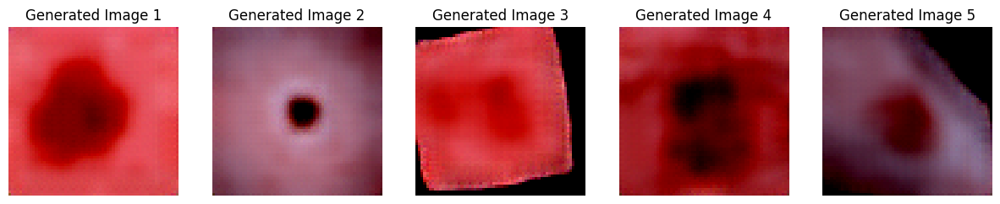

Epoch:6 | Train Loss:0.012304295376417744 | Rec Loss:0.009708783589303493


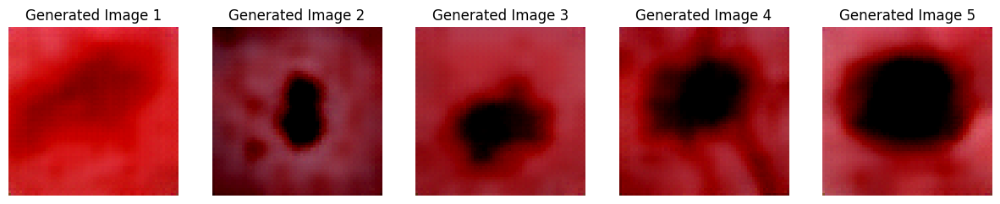

Epoch:7 | Train Loss:0.011119572350838382 | Rec Loss:0.007637660484761


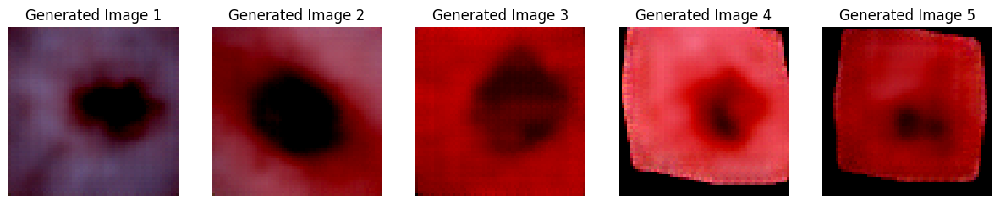

Epoch:8 | Train Loss:0.010194379320237666 | Rec Loss:0.006549476180225611


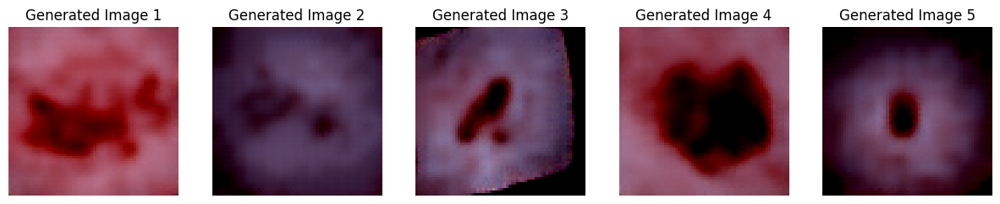

Epoch:9 | Train Loss:0.009477092831093034 | Rec Loss:0.00944475643336773


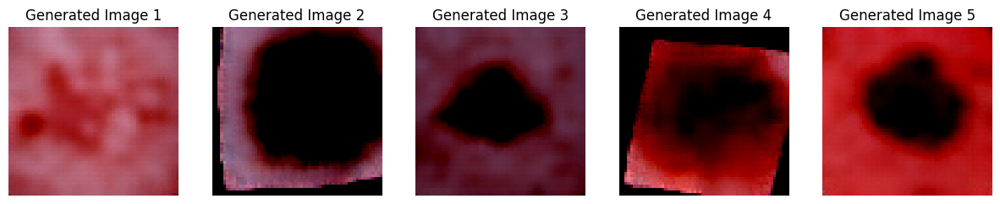

Epoch:10 | Train Loss:0.009026178968536436 | Rec Loss:0.006276034750044346


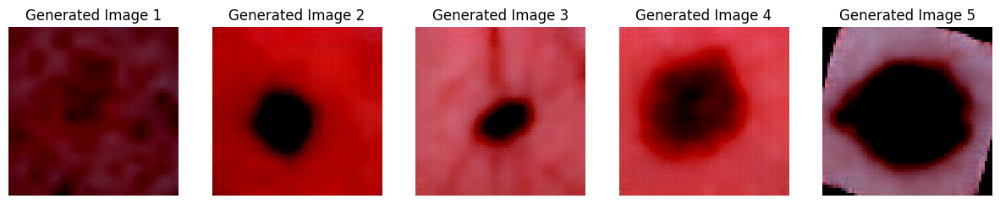

Epoch:11 | Train Loss:0.008382279502975333 | Rec Loss:0.004691921640187502


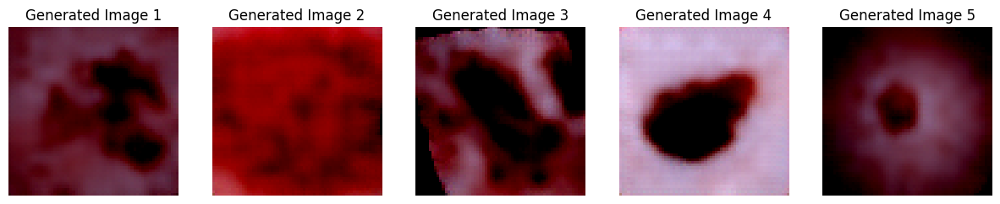

Epoch:12 | Train Loss:0.007953627883296484 | Rec Loss:0.006552867125719786


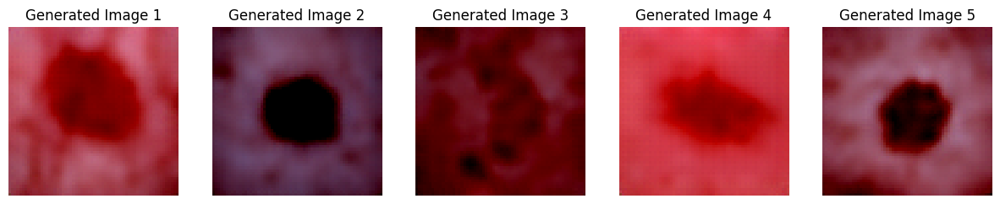

Epoch:13 | Train Loss:0.007713471091453247 | Rec Loss:0.004049394279718399


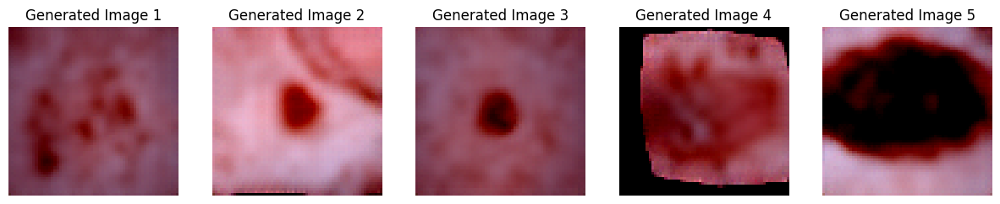

Epoch:14 | Train Loss:0.007451320571267301 | Rec Loss:0.005653967149555683


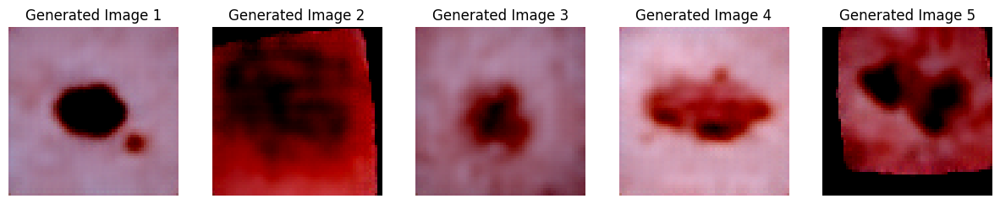

Epoch:15 | Train Loss:0.007062866275382649 | Rec Loss:0.005919075105339289


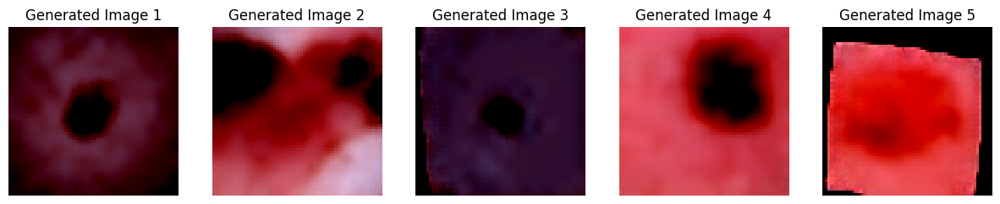

Epoch:16 | Train Loss:0.006901111602071364 | Rec Loss:0.004738801624625921


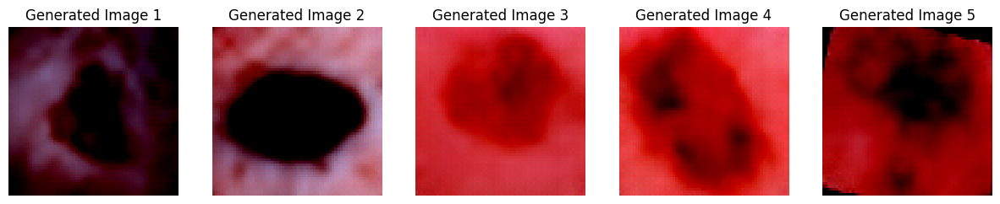

Epoch:17 | Train Loss:0.006711520577905474 | Rec Loss:0.004796071909368038


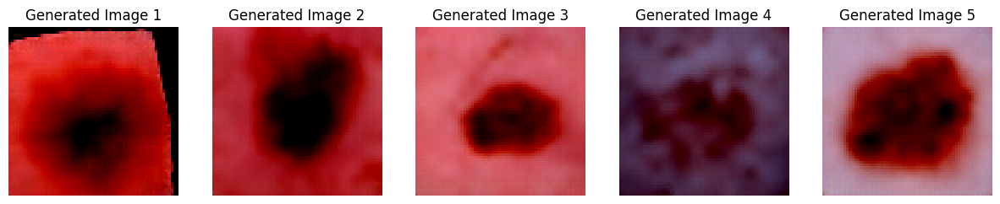

Epoch:18 | Train Loss:0.006670493175791707 | Rec Loss:0.004790653940290213


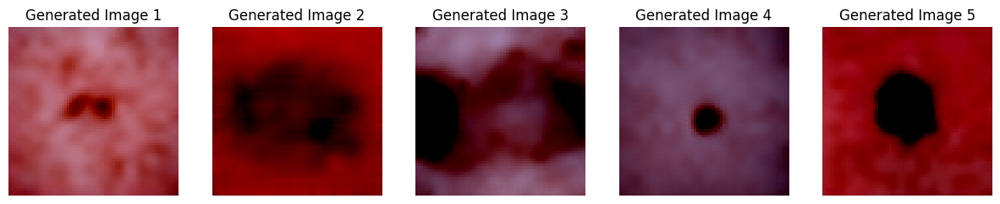

Epoch:19 | Train Loss:0.00642542830508226 | Rec Loss:0.004290825687348843


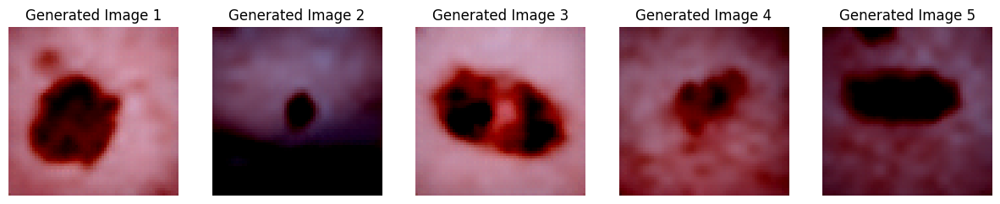

Epoch:20 | Train Loss:0.006375693357223348 | Rec Loss:0.005901479162275791


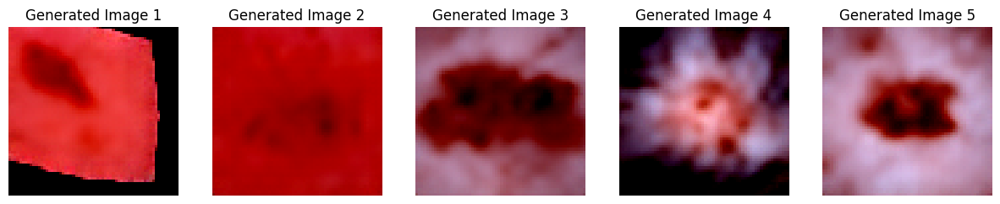

Epoch:21 | Train Loss:0.006278278673910032 | Rec Loss:0.003753187134861946


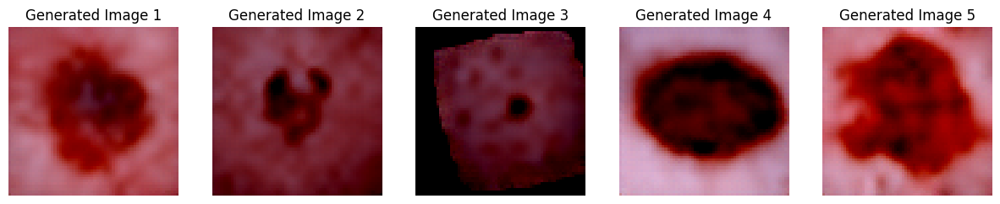

Epoch:22 | Train Loss:0.006182079013603128 | Rec Loss:0.0050346325151622295


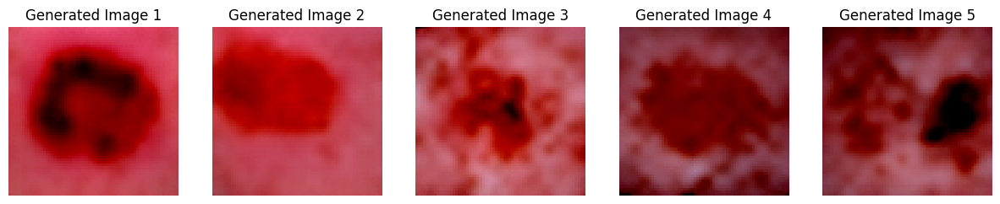

Epoch:23 | Train Loss:0.0063352499180918285 | Rec Loss:0.0046006254851818085


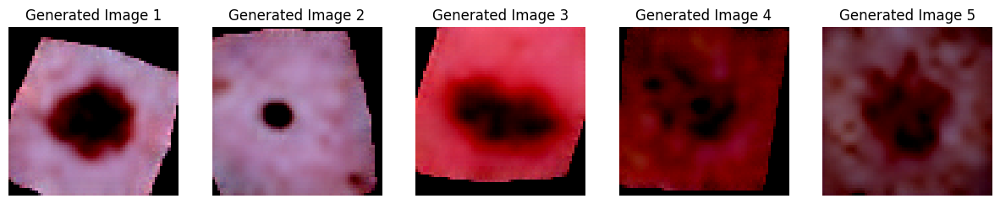

Epoch:24 | Train Loss:0.007256455007632067 | Rec Loss:0.004903051070868969


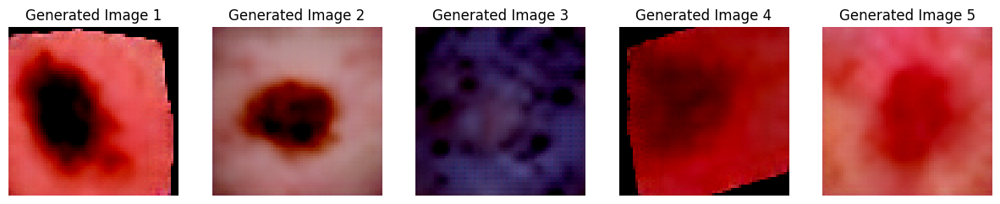

Epoch:25 | Train Loss:0.006629313205837444 | Rec Loss:0.004250476602464914


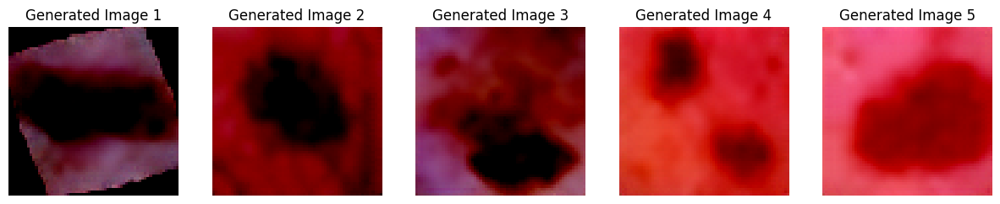

Epoch:26 | Train Loss:0.006497242811260519 | Rec Loss:0.0033645136281847954


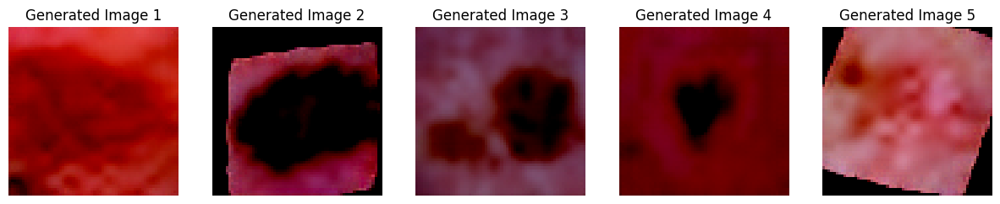

Epoch:27 | Train Loss:0.0064259525685078775 | Rec Loss:0.003970520570874214


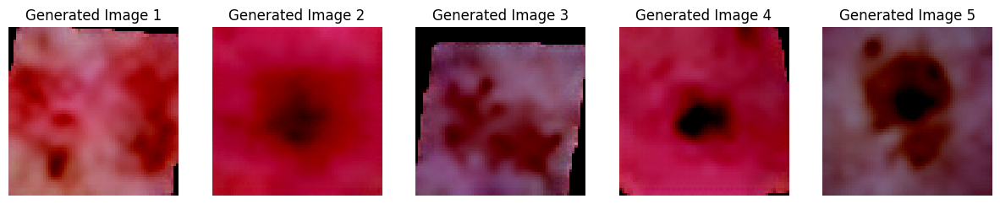

Epoch:28 | Train Loss:0.006333568963892521 | Rec Loss:0.003973969724029303


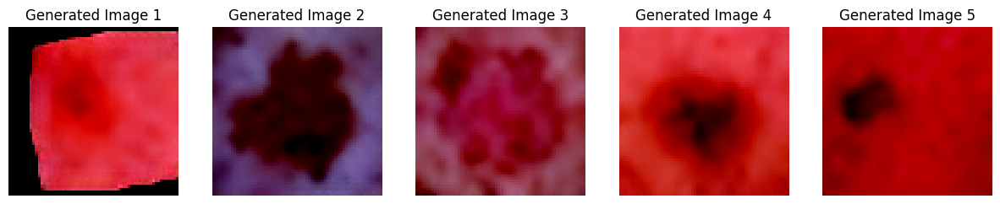

Epoch:29 | Train Loss:0.006200265177899295 | Rec Loss:0.004188004415482283


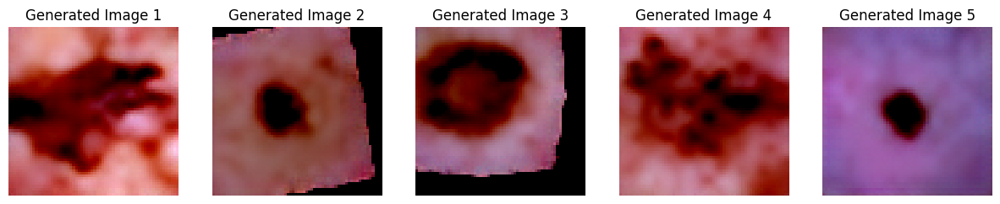

Epoch:30 | Train Loss:0.006088347426336852 | Rec Loss:0.003473440883681178


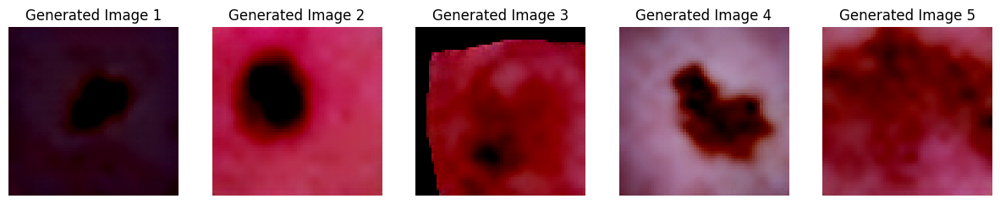

Epoch:31 | Train Loss:0.005970460831359693 | Rec Loss:0.004768723621964455


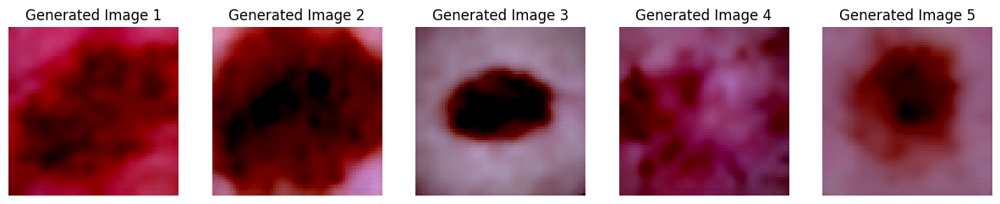

Epoch:32 | Train Loss:0.005959462060053257 | Rec Loss:0.0038111882749944925


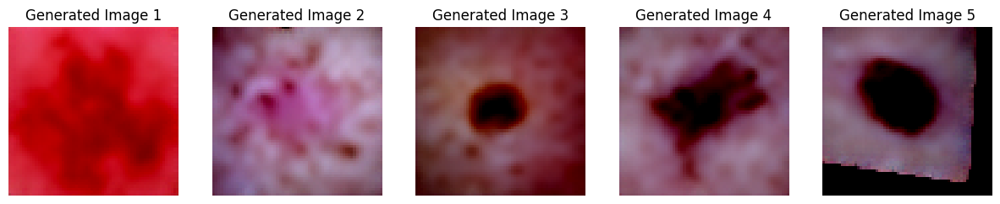

Epoch:33 | Train Loss:0.00587328055363362 | Rec Loss:0.003889302955940366


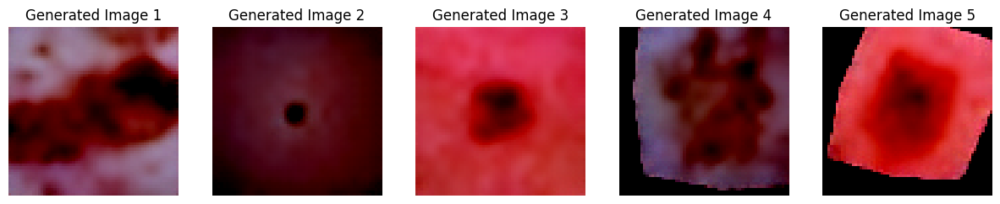

Epoch:34 | Train Loss:0.005686350650254898 | Rec Loss:0.002744398545473814


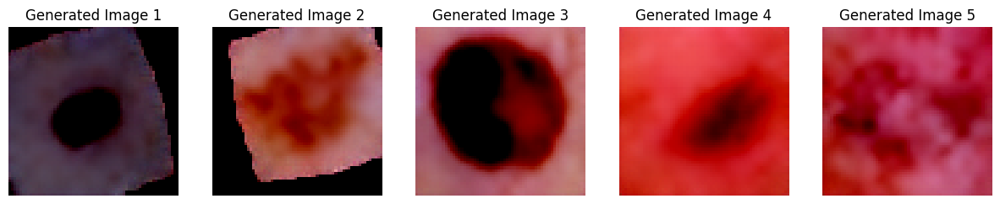

Epoch:35 | Train Loss:0.005639741953557274 | Rec Loss:0.0039660027250647545


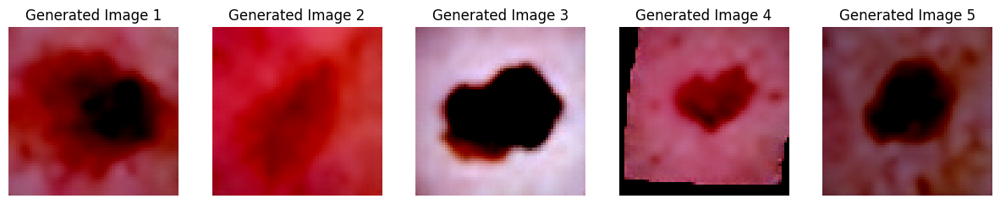

Epoch:36 | Train Loss:0.005595103158336726 | Rec Loss:0.0038870656862854958


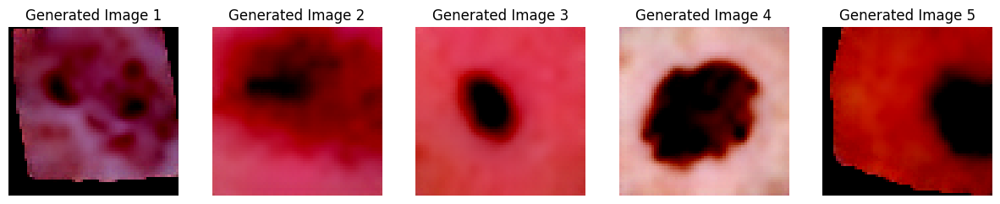

Epoch:37 | Train Loss:0.005555205355594113 | Rec Loss:0.0035242142621427774


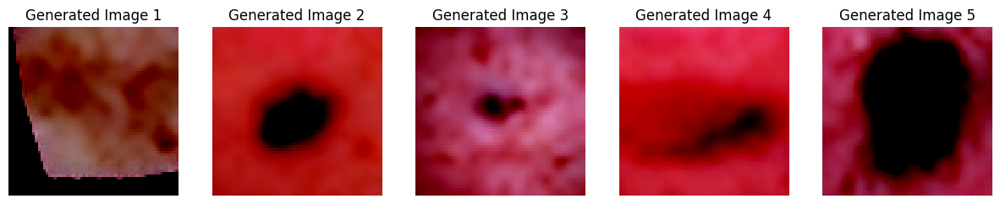

Epoch:38 | Train Loss:0.005385452831033499 | Rec Loss:0.002741205506026745


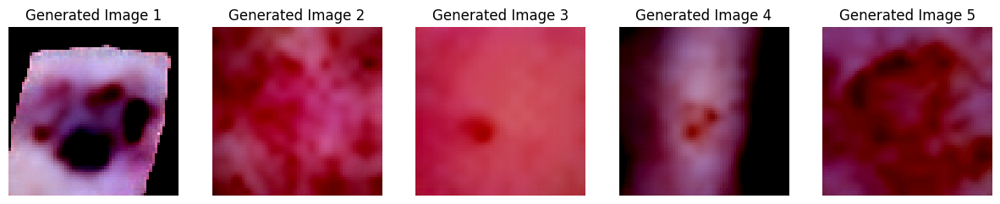

Epoch:39 | Train Loss:0.005385587279607726 | Rec Loss:0.0033617238514125347


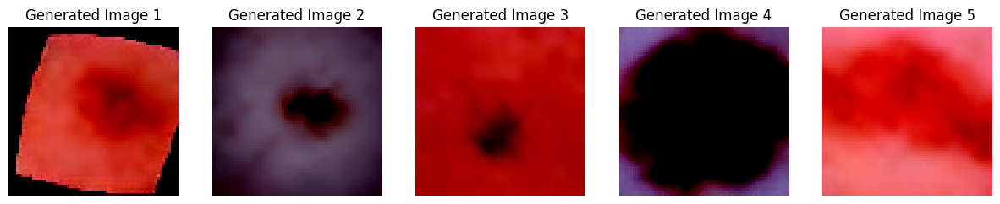

Epoch:40 | Train Loss:0.005311808946311094 | Rec Loss:0.0028082497883588076


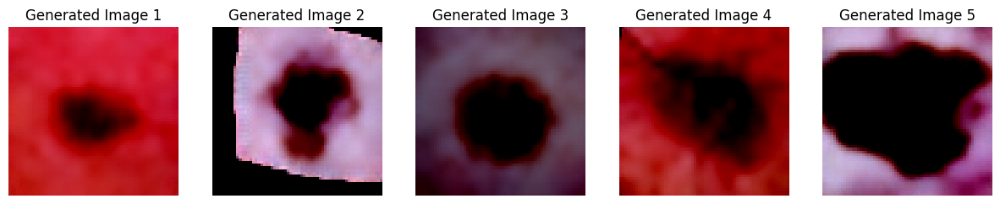

Epoch:41 | Train Loss:0.005248517720443997 | Rec Loss:0.003665110794827342


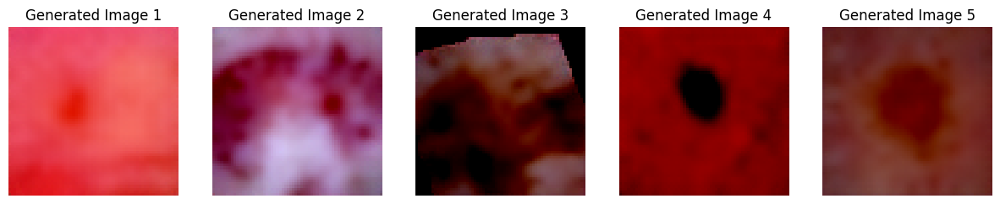

Epoch:42 | Train Loss:0.00518688469069304 | Rec Loss:0.0036553291138261557


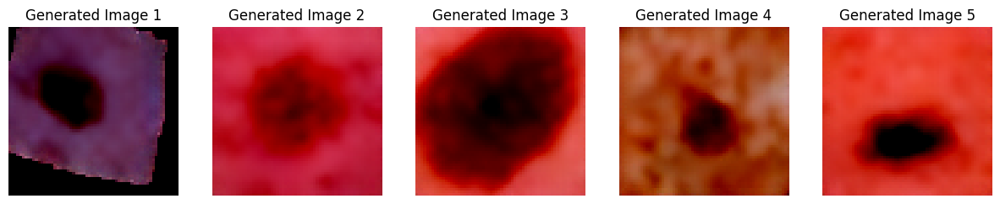

Epoch:43 | Train Loss:0.005226839787569965 | Rec Loss:0.002359239384531975


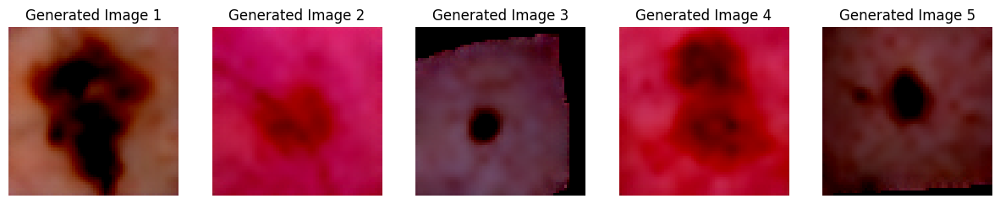

Epoch:44 | Train Loss:0.005163169590530882 | Rec Loss:0.0037009043153375387


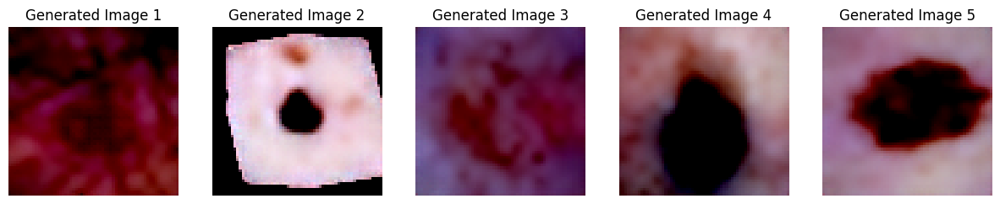

Epoch:45 | Train Loss:0.005056791569574908 | Rec Loss:0.003960031550377607


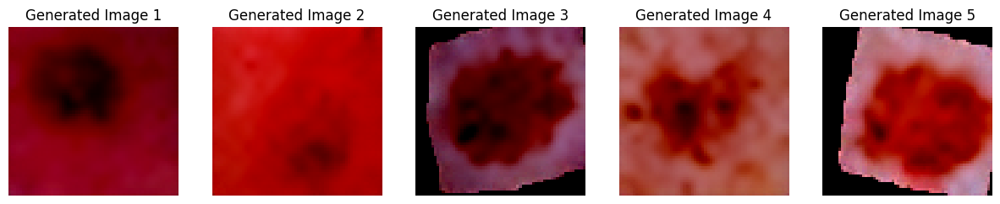

Epoch:46 | Train Loss:0.005021655534625433 | Rec Loss:0.0023502896074205637


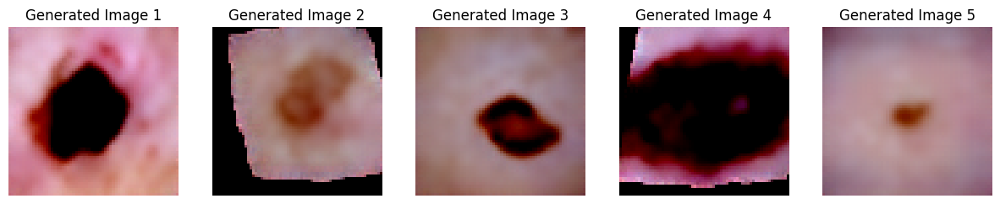

Epoch:47 | Train Loss:0.005010847553942994 | Rec Loss:0.0034108059480786324


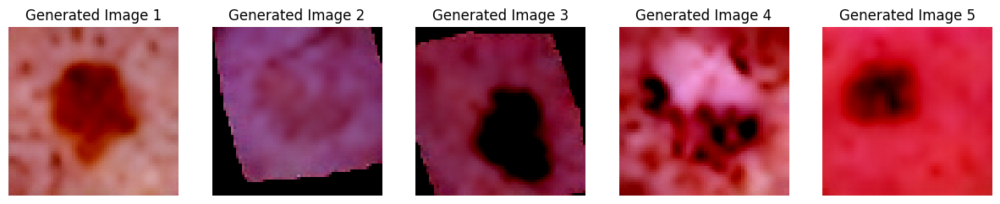

Epoch:48 | Train Loss:0.0049095329855254315 | Rec Loss:0.0033344984985888004


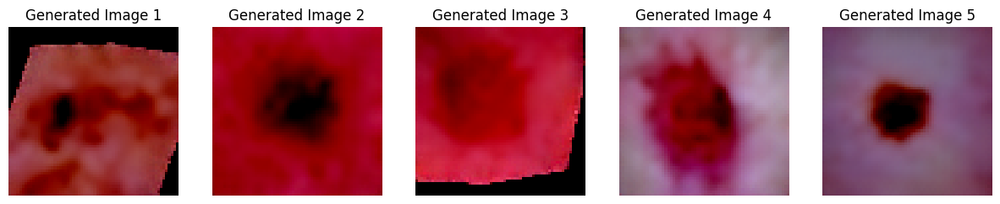

Epoch:49 | Train Loss:0.004944332664725697 | Rec Loss:0.0030641464982181787


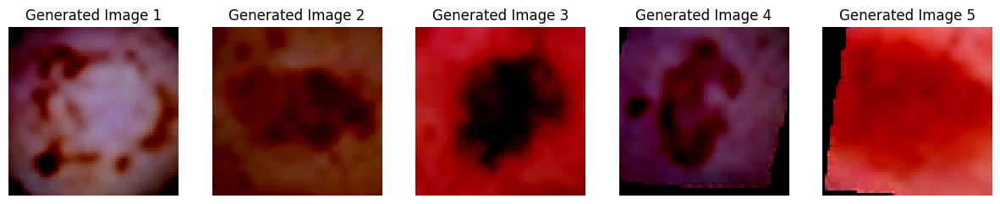

Epoch:50 | Train Loss:0.0048987881671993215 | Rec Loss:0.002878011204302311


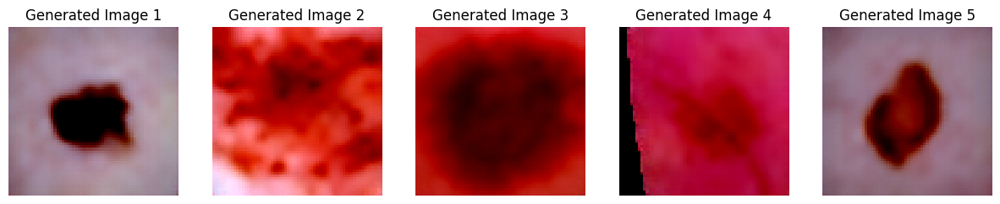

Epoch:51 | Train Loss:0.0048931109285943065 | Rec Loss:0.002593723125755787


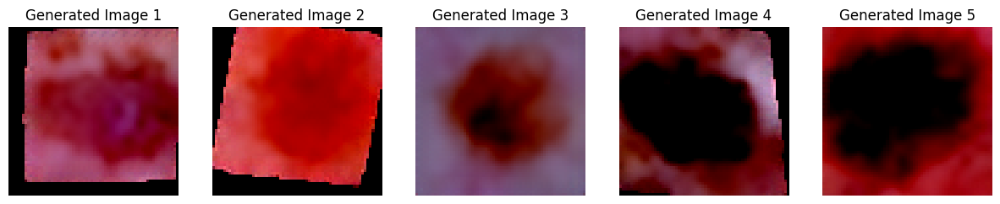

Epoch:52 | Train Loss:0.00479577535727791 | Rec Loss:0.0028332096990197897


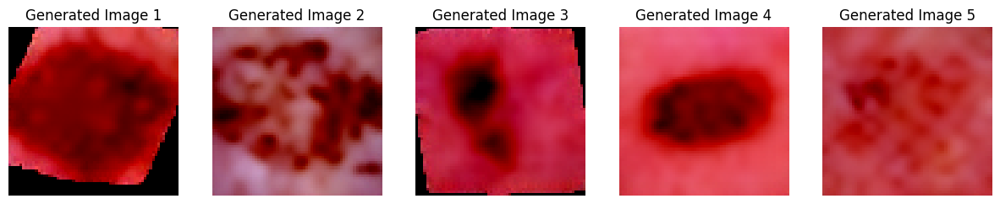

Epoch:53 | Train Loss:0.00481837664013076 | Rec Loss:0.00248322868719697


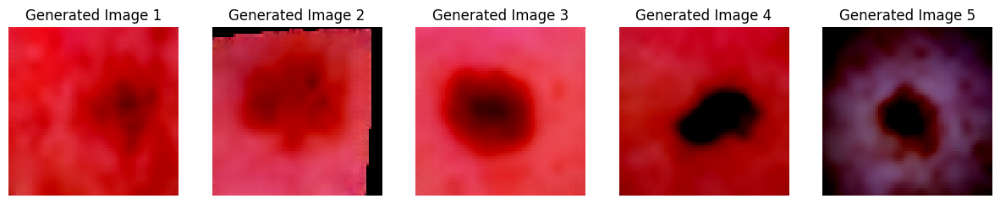

Epoch:54 | Train Loss:0.004706589886206825 | Rec Loss:0.002876783488318324


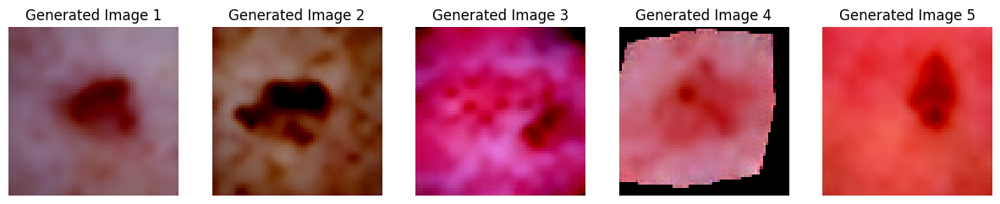

Epoch:55 | Train Loss:0.004748134879739421 | Rec Loss:0.0034480479080229998


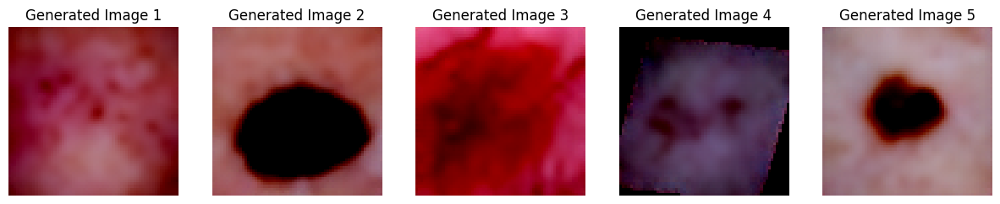

Epoch:56 | Train Loss:0.004668123029457156 | Rec Loss:0.0027797850780189037


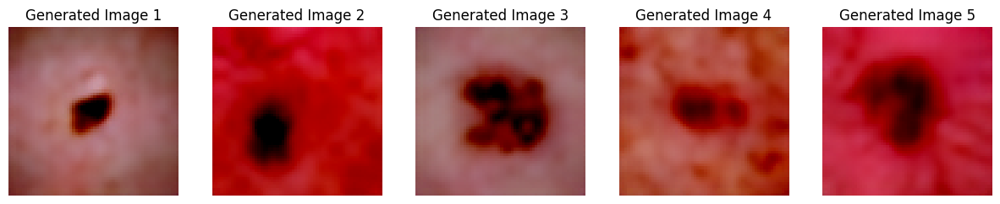

Epoch:57 | Train Loss:0.004670691978969392 | Rec Loss:0.0023320394102483988


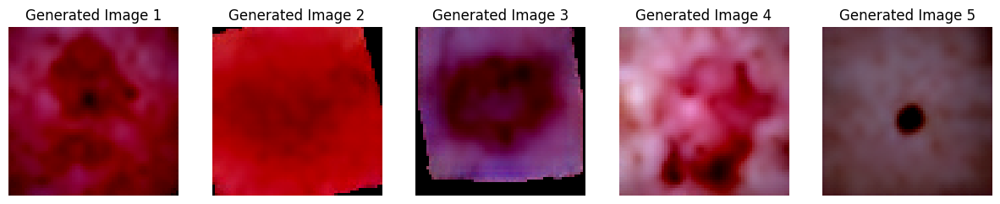

Epoch:58 | Train Loss:0.004636288845947214 | Rec Loss:0.00219142553396523


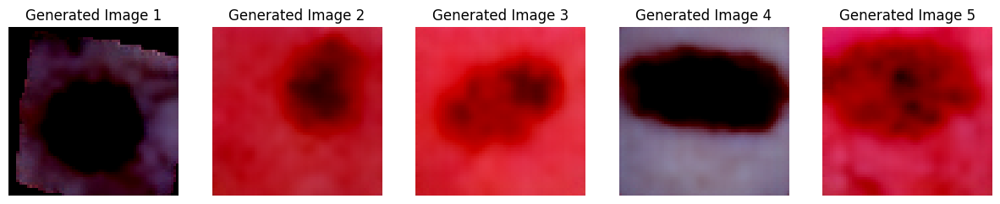

Epoch:59 | Train Loss:0.004580588753269926 | Rec Loss:0.0029828299302607775


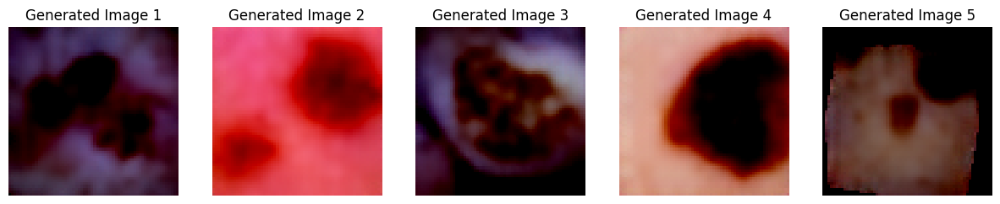

Epoch:60 | Train Loss:0.004646634100194854 | Rec Loss:0.003407921874895692


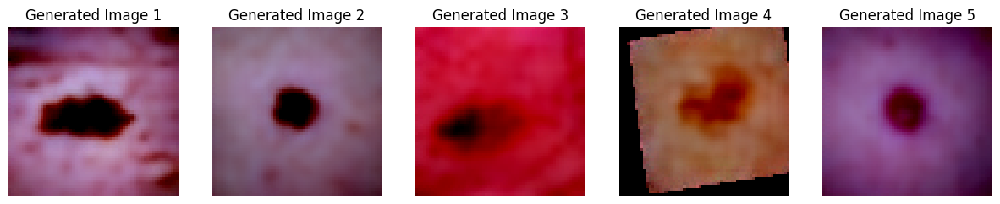

Epoch:61 | Train Loss:0.004595821314034568 | Rec Loss:0.0027543222531676292


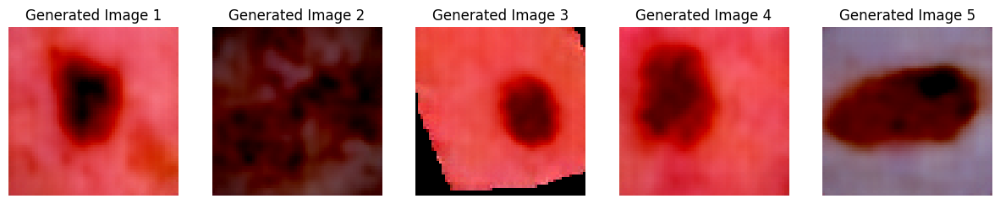

Epoch:62 | Train Loss:0.004524273409324277 | Rec Loss:0.002587313298135996


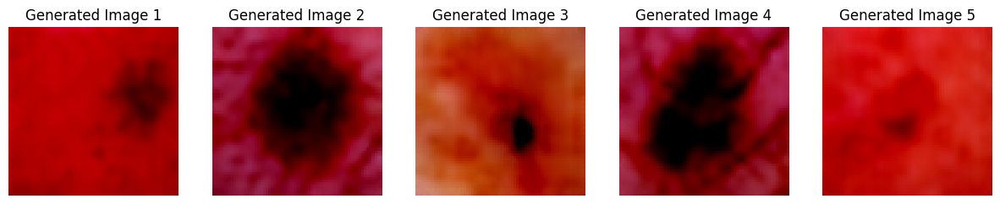

Epoch:63 | Train Loss:0.004502186802316718 | Rec Loss:0.003062987234443426


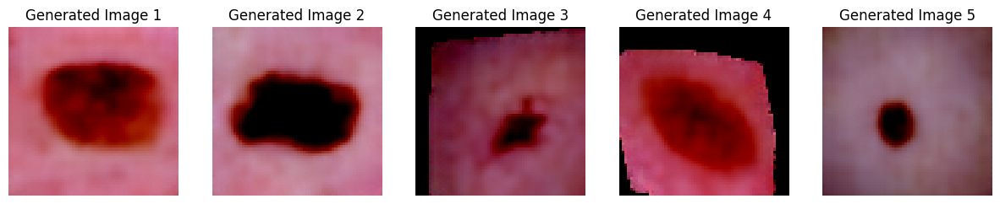

Epoch:64 | Train Loss:0.004497059789978585 | Rec Loss:0.0025440403260290623


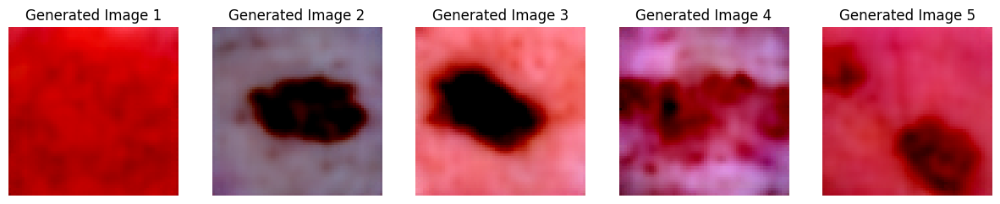

Epoch:65 | Train Loss:0.004501379329331551 | Rec Loss:0.003271975088864565


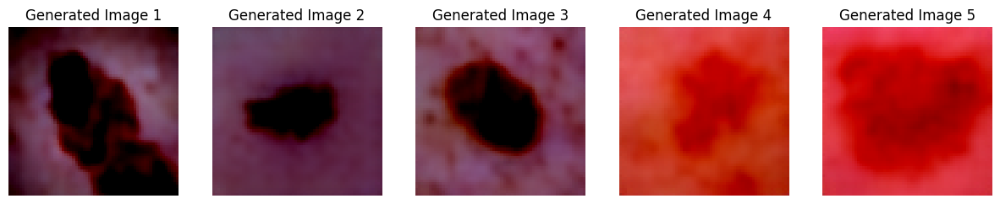

Epoch:66 | Train Loss:0.004440618708587376 | Rec Loss:0.0029628726188093424


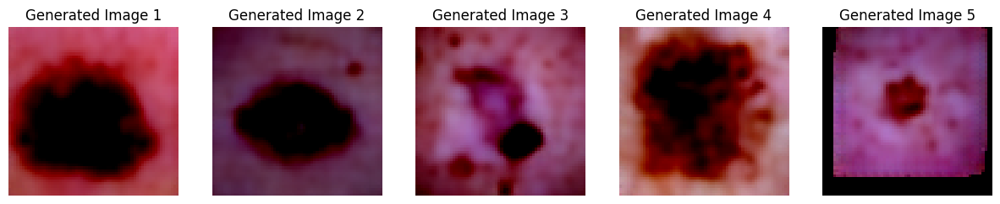

Epoch:67 | Train Loss:0.004440776594457733 | Rec Loss:0.0027466120664030313


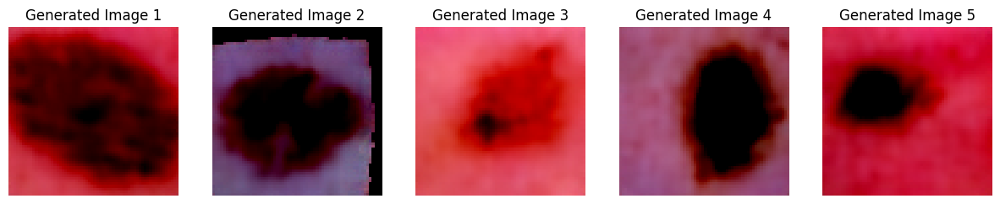

Epoch:68 | Train Loss:0.004457437655752062 | Rec Loss:0.0025679615791887045


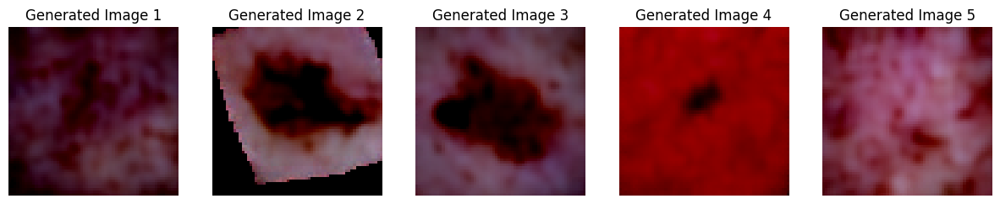

Epoch:69 | Train Loss:0.004485400678340796 | Rec Loss:0.0024479874409735203


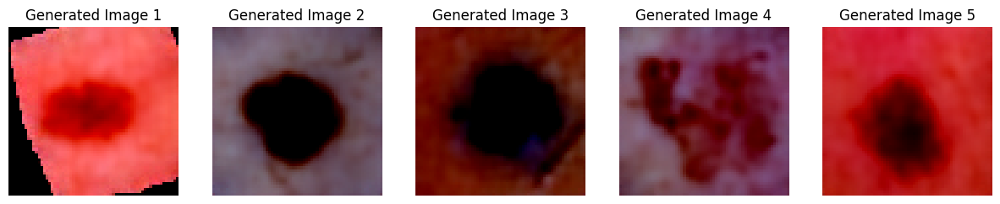

Epoch:70 | Train Loss:0.004418962523875058 | Rec Loss:0.0021150922402739525


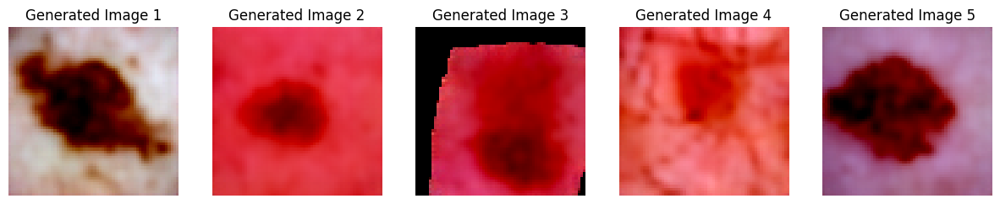

Epoch:71 | Train Loss:0.004454305107782411 | Rec Loss:0.0027527683414518833


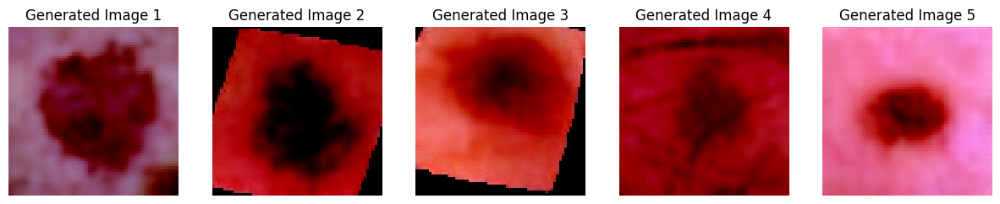

Epoch:72 | Train Loss:0.004403503355125238 | Rec Loss:0.0027389719616621733


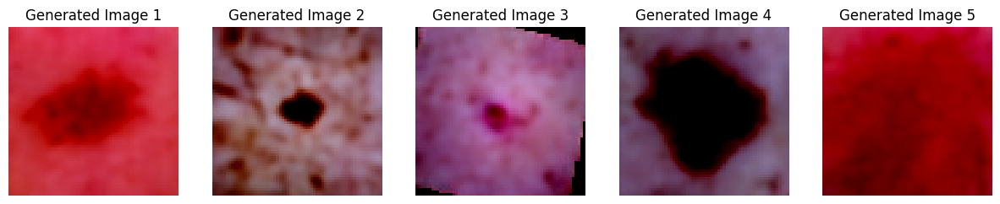

Epoch:73 | Train Loss:0.004464460843818108 | Rec Loss:0.002271827310323715


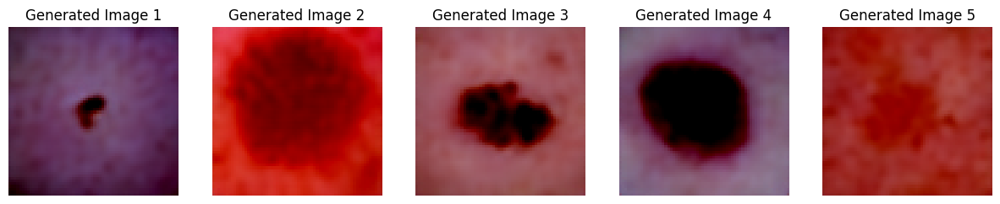

Epoch:74 | Train Loss:0.004370988981359324 | Rec Loss:0.001700986991636455


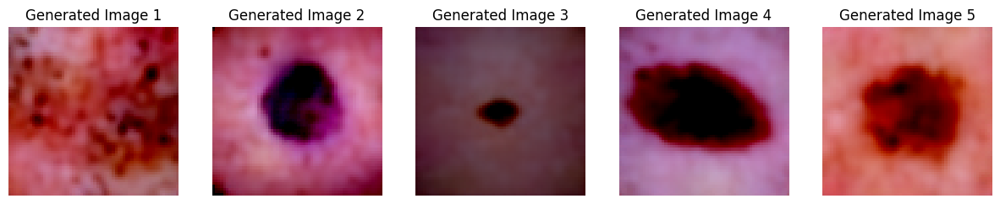

Epoch:75 | Train Loss:0.004375209813866361 | Rec Loss:0.0024425433948636055


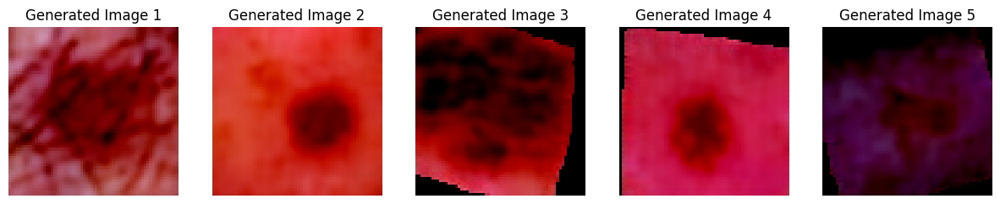

Epoch:76 | Train Loss:0.004339489169347628 | Rec Loss:0.002676987322047353


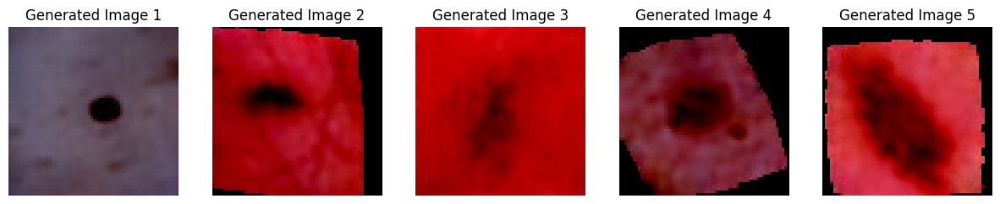

Epoch:77 | Train Loss:0.0043073873492373025 | Rec Loss:0.0018087407806888223


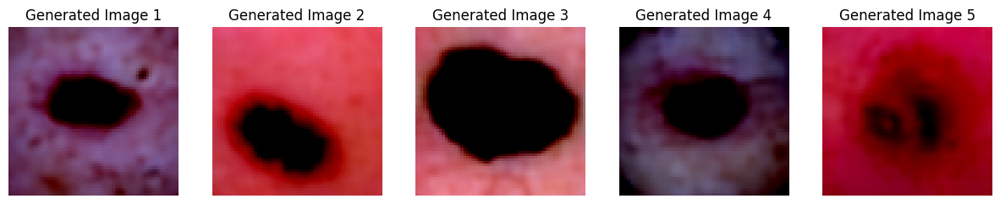

Epoch:78 | Train Loss:0.004359883223630631 | Rec Loss:0.0018524805782362819


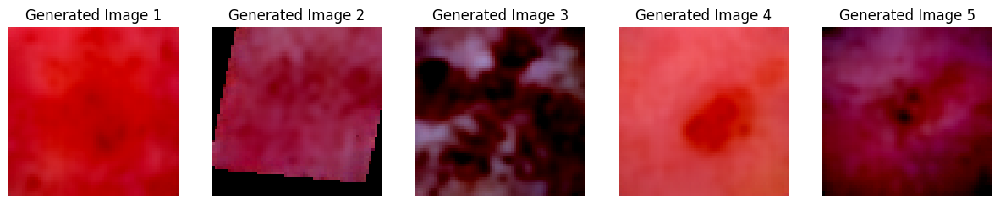

Epoch:79 | Train Loss:0.004339174011567975 | Rec Loss:0.0023595041129738092


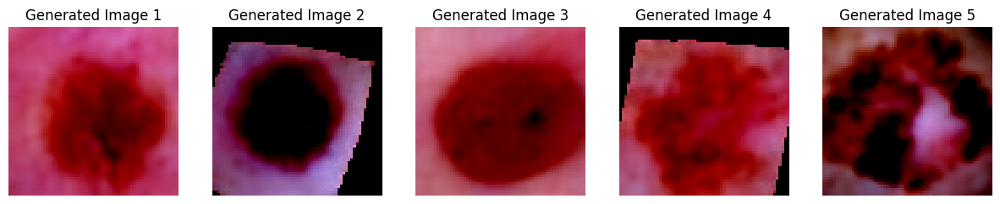

Epoch:80 | Train Loss:0.004336900421815693 | Rec Loss:0.0019266906892880797


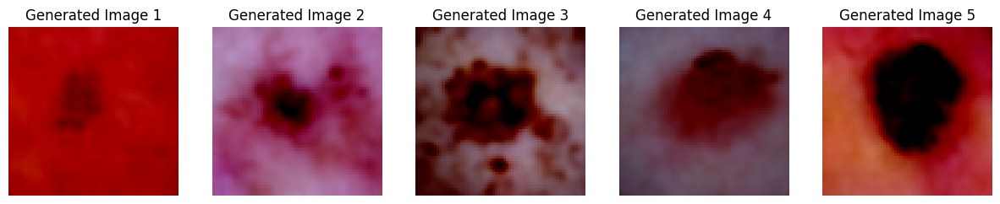

Epoch:81 | Train Loss:0.004425386441456285 | Rec Loss:0.0018976147985085845


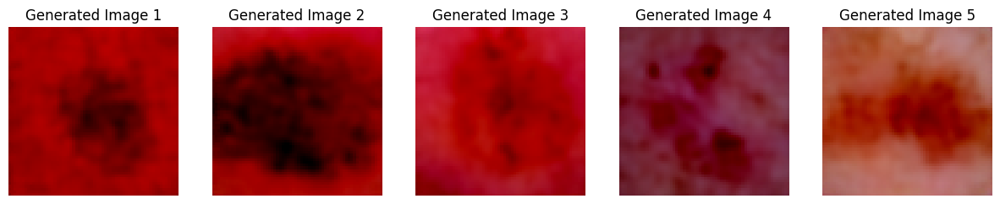

Epoch:82 | Train Loss:0.004317207296028923 | Rec Loss:0.0024594017304480076


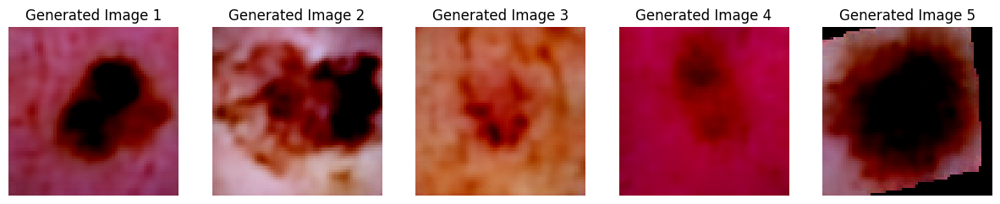

Epoch:83 | Train Loss:0.004360446110249135 | Rec Loss:0.0020754686556756496


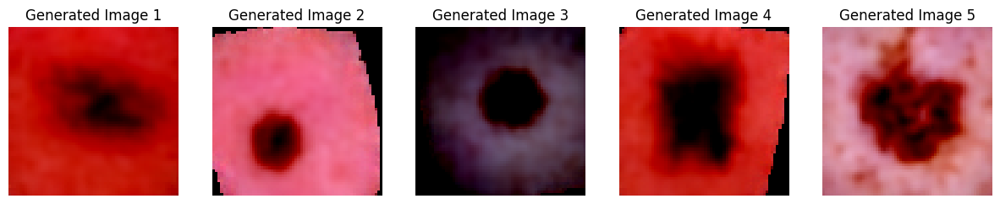

Epoch:84 | Train Loss:0.004362147225802586 | Rec Loss:0.002011193661019206


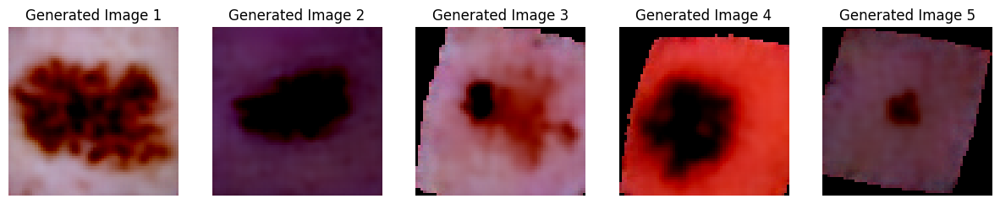

Epoch:85 | Train Loss:0.004329283140409904 | Rec Loss:0.002196317072957754


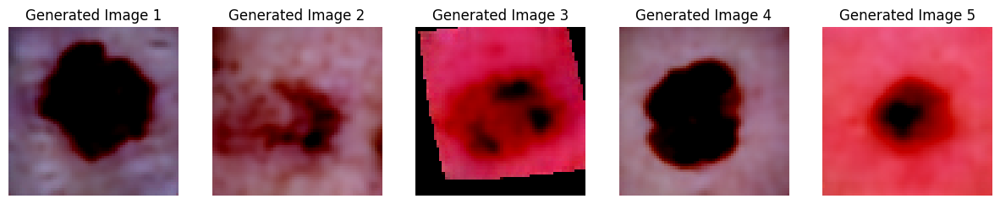

Epoch:86 | Train Loss:0.004276257887731787 | Rec Loss:0.0018584196222946048


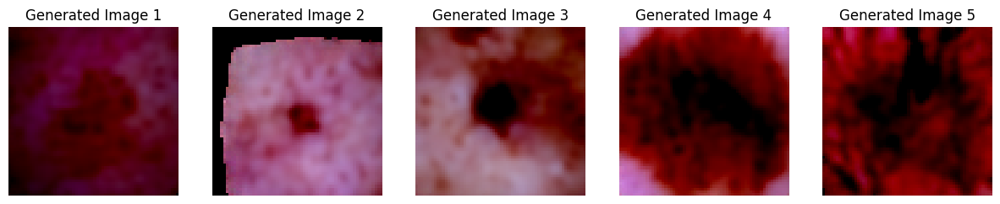

Epoch:87 | Train Loss:0.00431838677899473 | Rec Loss:0.0019223695853725076


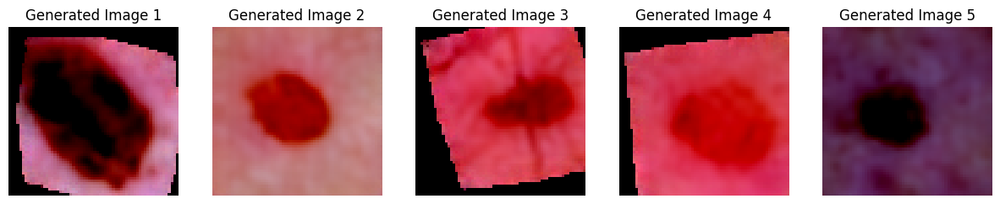

Epoch:88 | Train Loss:0.004263382471777546 | Rec Loss:0.0017073589842766523


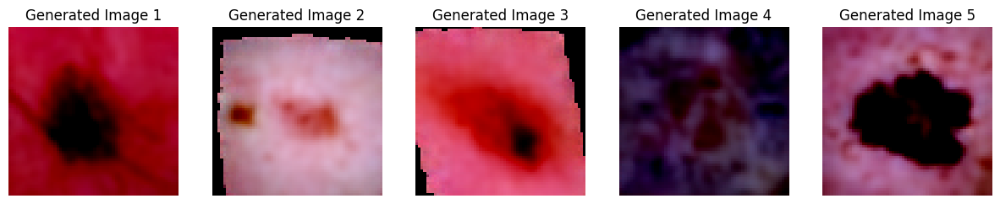

Epoch:89 | Train Loss:0.004262386362964086 | Rec Loss:0.0017803371883928776


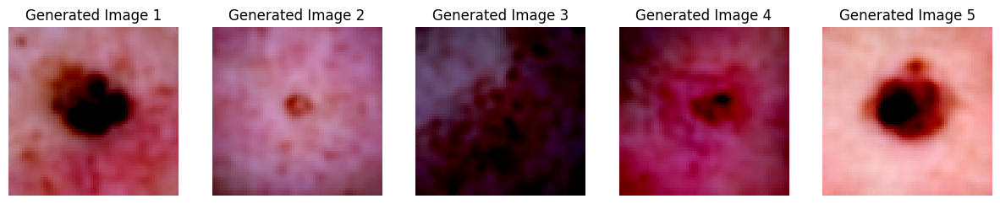

Epoch:90 | Train Loss:0.0042324296649616615 | Rec Loss:0.0017674783011898398


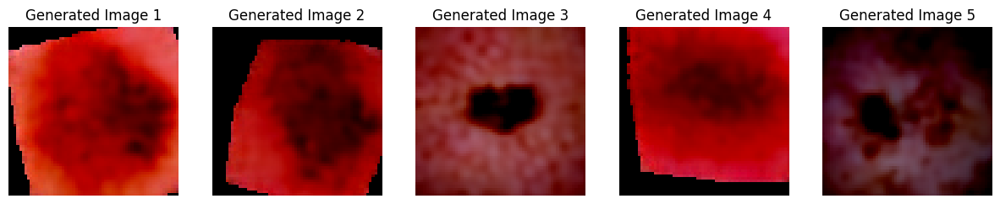

Epoch:91 | Train Loss:0.004245508116652157 | Rec Loss:0.0018679272616282105


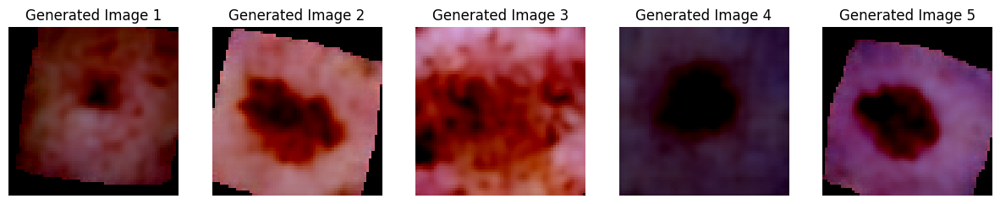

Epoch:92 | Train Loss:0.004228983615720823 | Rec Loss:0.001960676396265626


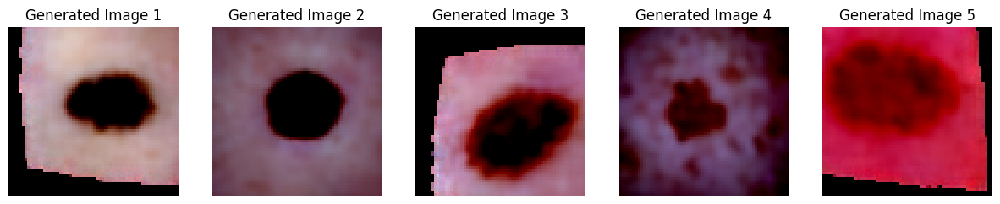

Epoch:93 | Train Loss:0.00425085252311057 | Rec Loss:0.0017321206396445632


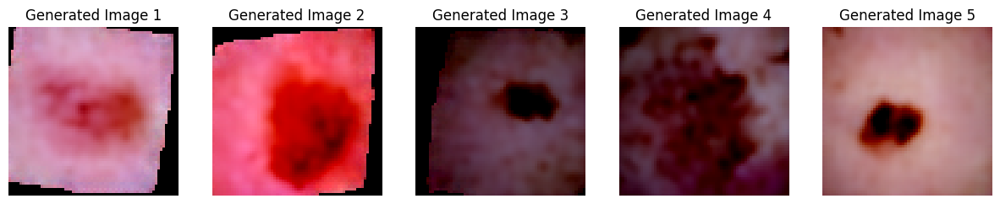

Epoch:94 | Train Loss:0.004226501262895051 | Rec Loss:0.0018724326509982347


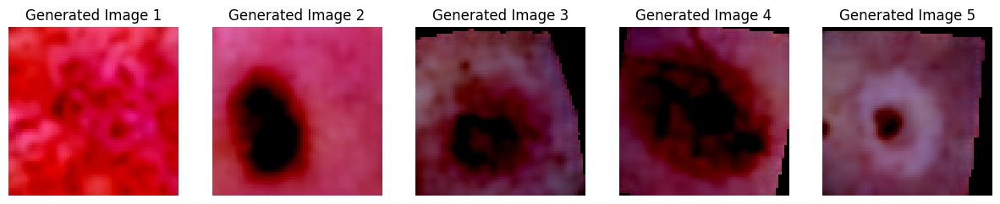

Epoch:95 | Train Loss:0.004283767114956952 | Rec Loss:0.0016358252614736557


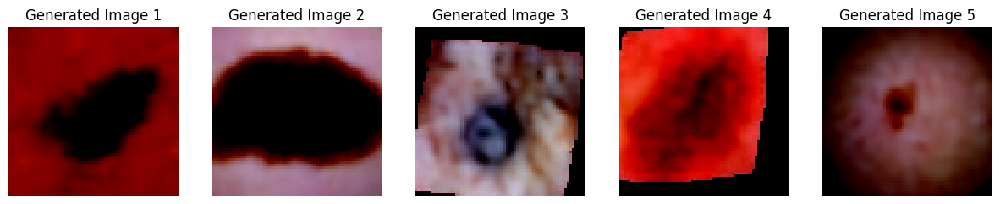

Epoch:96 | Train Loss:0.004245347067547642 | Rec Loss:0.002075473079457879


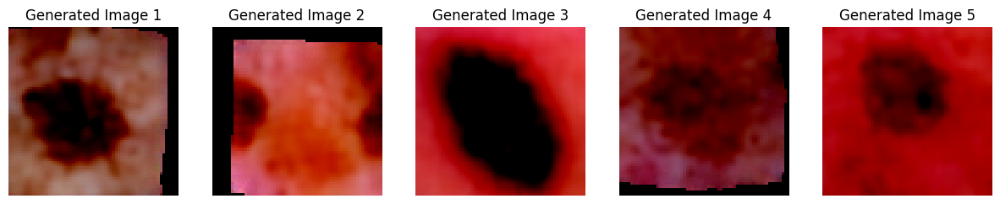

Epoch:97 | Train Loss:0.004190499935844901 | Rec Loss:0.001836163573898375


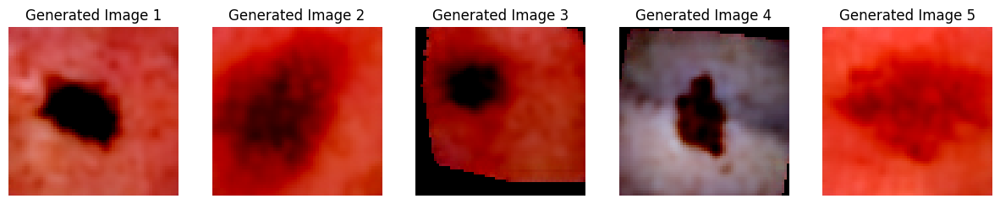

Epoch:98 | Train Loss:0.0041662296339584765 | Rec Loss:0.00169374980032444


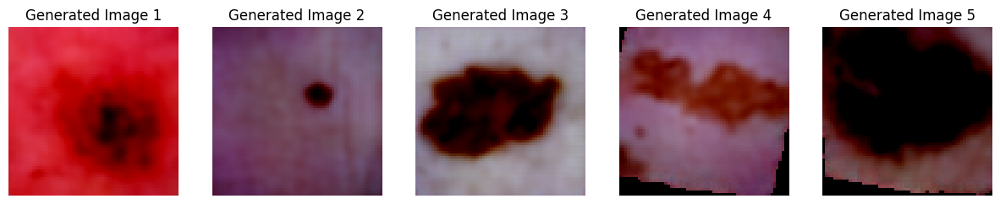

Epoch:99 | Train Loss:0.004234632626947039 | Rec Loss:0.002015512203797698


In [124]:
train_losses = []
rec_losses = []
num_epochs = 100
#vq_vae = model.to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)
# Training loop
import matplotlib.pyplot as plt

# Define the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Move the model to the device
model = model.to(device)

# Training loop
for epoch in range(num_epochs):
    # Set model to training mode
    model.train()

    # Iterate over the dataset
    train_loss = 0
    rec_loss2= 0
    for i, inputs in enumerate(train_loader):
        inputs = inputs.to(device)  # Move input data to GPU if available
        optimizer.zero_grad()
        model.train()
        loss,_,rec_loss = model(inputs)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        rec_loss2+= rec_loss.item()

    train_loss /= len(train_loader)
    
    train_losses.append(train_loss)
    rec_losses.append(rec_loss2)

    # Set model to evaluation mode and generate images
    model.eval()
    with torch.no_grad():
        generated_images = []
        for i, inputs in enumerate(train_loader):
            inputs = inputs.to(device)  # Move input data to GPU if available
            _, reconstructions,_ = model(inputs)
            generated_images.append(reconstructions)
            if i == 4:  # Plot 5 images
                break

    # Plot 5 generated images
    plt.figure(figsize=(15, 6))
    for i in range(5):
        plt.subplot(1, 5, i+1)
        plt.imshow(generated_images[i][0].cpu().numpy().transpose(1, 2, 0))  # Convert tensor to numpy array and transpose
        plt.title('Generated Image {}'.format(i+1))
        plt.axis('off')
    plt.show()

    print(f"Epoch:{epoch} | Train Loss:{train_loss} | Rec Loss:{rec_loss}")


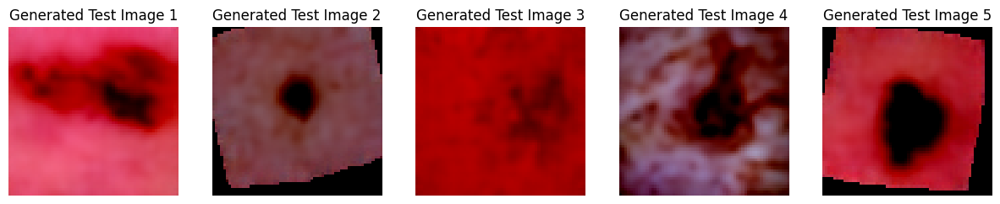

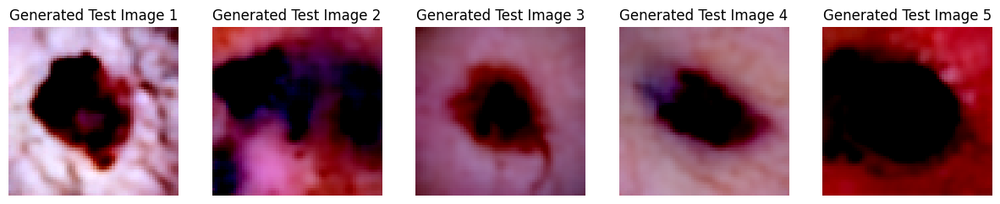

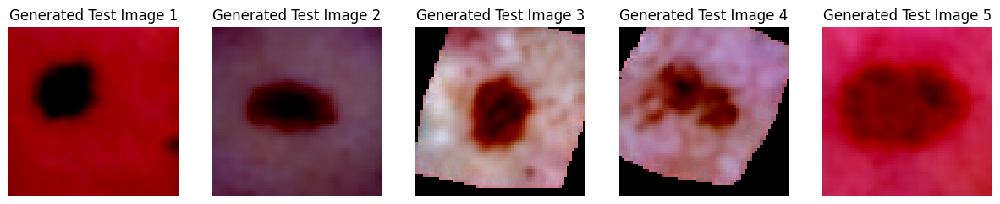

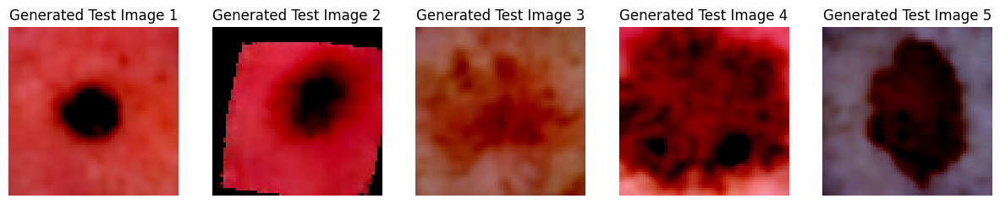

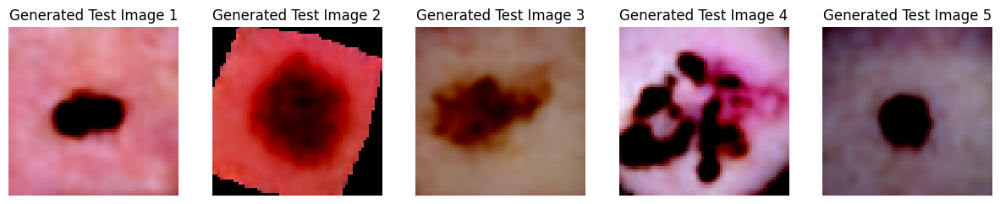

In [125]:
import matplotlib.pyplot as plt

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
epochtest=5
# Move the model to the device
model = model.to(device)

test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)
# Training loop
for epoch in range(epochtest):
    # Set model to evaluation mode
    model.eval()
    
    # Initialize an empty list to store generated images
    generated_images = []
    
    # Iterate over the test loader
    for i, inputs in enumerate(test_loader):
        inputs = inputs.to(device)  # Move input data to GPU if available
        _, reconstructions, _ = model(inputs)
        generated_images.append(reconstructions.detach())  # Detach the tensor here
        if i == 4:  # Plot 5 images
            break

    # Plot 5 generated images
    plt.figure(figsize=(15, 6))
    for i in range(5):
        plt.subplot(1, 5, i+1)
        plt.imshow(generated_images[i][0].cpu().numpy().transpose(1, 2, 0))  # Convert tensor to numpy array and transpose
        plt.title('Generated Test Image {}'.format(i+1))
        plt.axis('off')
    plt.show()


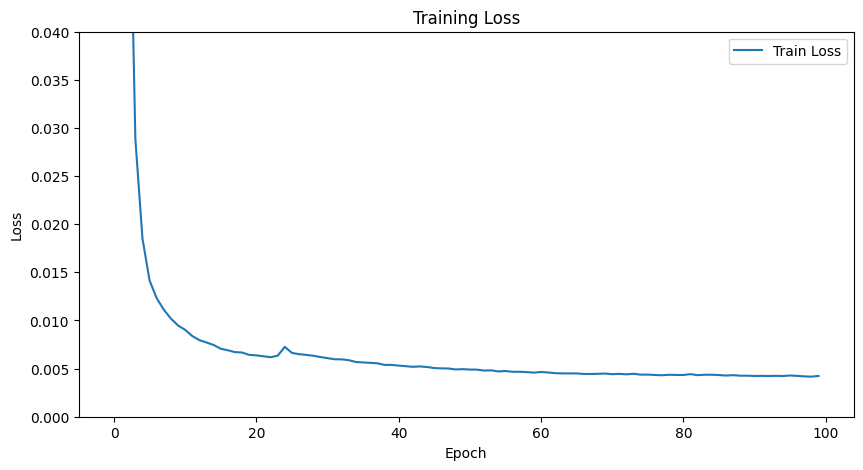

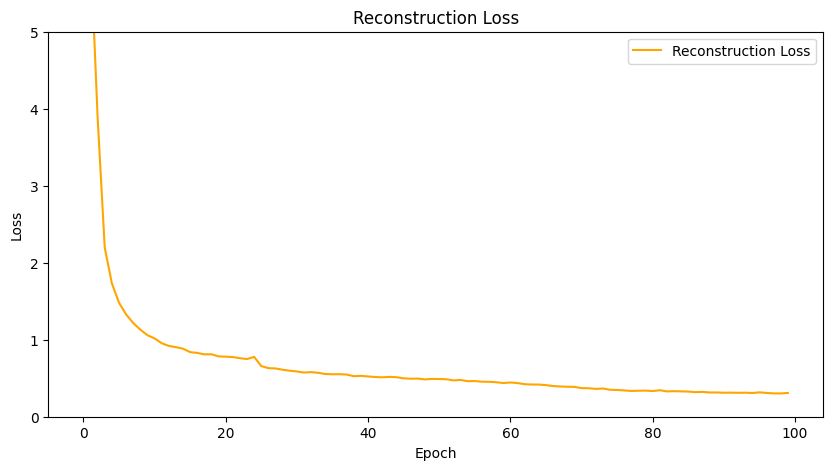

In [144]:
# Plot the training loss
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Train Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.ylim(0.0, 0.04)
plt.legend()
plt.show()

# Plot the reconstruction loss
plt.figure(figsize=(10, 5))
plt.plot(rec_losses, label='Reconstruction Loss', color='orange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Reconstruction Loss')
plt.ylim(0.0, 5.0)
plt.legend()
plt.show()


In [127]:
class Model2(nn.Module):

    def __init__(self,num_embeddings=512,embedding_dim=64,commitment_cost=0.25):
        super().__init__()

        self.embedding_dim = embedding_dim
        self.num_embeddings = num_embeddings
        self.commitment_cost = commitment_cost

        #encode
        self.conv1 = nn.Conv2d(3,64,kernel_size=4,stride=2,padding=1)
        self.conv2 = nn.Conv2d(64,128,kernel_size=4,stride=2,padding=1)
        self.conv3 = nn.Conv2d(128,128,kernel_size=3,stride=1,padding=1)
        self.resblock1 = ResudialStack(128,128,64,3)

        #vq
        self.vq_conv = nn.Conv2d(128,self.embedding_dim,kernel_size=1,stride=1)
        self.vq = VQ(self.num_embeddings,self.embedding_dim,self.commitment_cost)

        #decode
        self.conv4 = nn.Conv2d(self.embedding_dim,64,kernel_size=3,stride=1,padding=1)
        self.resblock2 = ResudialStack(64,64,32,3)
        self.conv5 = nn.ConvTranspose2d(64,32,kernel_size=4,stride=2,padding=1)
        self.conv6 = nn.ConvTranspose2d(32,3,kernel_size=4,stride=2,padding=1)


    def encode(self,x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = self.conv3(x)
        x = self.resblock1(x)
        return x

    def decode(self,quantized):
        x = self.conv4(quantized)
        x = self.resblock2(x)
        x = F.relu(self.conv5(x))
        x = self.conv6(x)
        return x

    def forward(self,inputs):
        x = self.encode(inputs)
        c_loss,quantized =  self.vq(self.vq_conv(x))
        v=quantized
        #print(quantized.shape)
        outputs = self.decode(quantized)
        rec_loss = F.mse_loss(outputs,inputs)
        loss = rec_loss + c_loss
        return loss,outputs,rec_loss,v

In [128]:
model2 = Model2()
num_epochs = 100
#vq_vae = model.to(device)
optimizer = optim.Adam(model2.parameters(), lr=0.001)
# Training loop
import matplotlib.pyplot as plt

# Define the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Move the model to the device
model2 = model2.to(device)

# Training loop
for epoch in range(num_epochs):
    # Set model to training mode
    model2.train()

    # Iterate over the dataset
    train_loss = 0
    for i, inputs in enumerate(train_loader):
        inputs = inputs.to(device)  # Move input data to GPU if available
        optimizer.zero_grad()
        model2.train()
        loss,_,rec_loss,_ = model2(inputs)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

    train_loss /= len(train_loader)

    # Set model to evaluation mode and generate images
    model2.eval()
    with torch.no_grad():
        generated_images = []
        for i, inputs in enumerate(train_loader):
            inputs = inputs.to(device)  # Move input data to GPU if available
            _, reconstructions,_,_ = model2(inputs)
            generated_images.append(reconstructions)
            if i == 4:  # Plot 5 images
                break

#     # Plot 5 generated images
#     plt.figure(figsize=(15, 6))
#     for i in range(5):
#         plt.subplot(1, 5, i+1)
#         plt.imshow(generated_images[i][0].cpu().numpy().transpose(1, 2, 0))  # Convert tensor to numpy array and transpose
#         plt.title('Generated Image {}'.format(i+1))
#         plt.axis('off')
#     plt.show()

    print(f"Epoch:{epoch} | Train Loss:{train_loss} | Rec Loss:{rec_loss}")


Epoch:0 | Train Loss:4.192007208895531 | Rec Loss:0.0473095066845417
Epoch:1 | Train Loss:0.3026280200500397 | Rec Loss:0.03275197371840477
Epoch:2 | Train Loss:0.04935345186549387 | Rec Loss:0.01654505729675293
Epoch:3 | Train Loss:0.027429476890499425 | Rec Loss:0.014942946843802929
Epoch:4 | Train Loss:0.020041942323563964 | Rec Loss:0.01090681180357933
Epoch:5 | Train Loss:0.015047119147363742 | Rec Loss:0.010143627412617207
Epoch:6 | Train Loss:0.012540742677820337 | Rec Loss:0.009590682573616505
Epoch:7 | Train Loss:0.010858829139144557 | Rec Loss:0.007210840005427599
Epoch:8 | Train Loss:0.00978091705270159 | Rec Loss:0.008037564344704151
Epoch:9 | Train Loss:0.009314727201274816 | Rec Loss:0.006782901007682085
Epoch:10 | Train Loss:0.008913978771158274 | Rec Loss:0.005430176854133606
Epoch:11 | Train Loss:0.008737641276945924 | Rec Loss:0.00785184558480978
Epoch:12 | Train Loss:0.008992452396874785 | Rec Loss:0.00474568223580718
Epoch:13 | Train Loss:0.008881285234953568 | Rec 

In [129]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class PixelCNN(nn.Module):
    def __init__(self, input_channels=64, num_filters=64, num_layers=10, num_initial_convs=2):
        super(PixelCNN, self).__init__()

        self.input_channels = input_channels
        self.num_filters = num_filters
        self.num_layers = num_layers
        self.num_initial_convs = num_initial_convs

        # Define the initial convolutional layers
        self.initial_convs = nn.ModuleList([
            nn.Conv2d(in_channels=input_channels if i == 0 else num_filters,
                      out_channels=num_filters,
                      kernel_size=3,
                      padding=1)
            for i in range(num_initial_convs)
        ])

        # Define the stack of masked convolutional layers
        self.conv_stack = nn.ModuleList([
            MaskedConv2d(in_channels=num_filters, out_channels=num_filters, kernel_size=3, padding=1)
            for _ in range(num_layers)
        ])

        # Define the output layer
        self.output_conv = nn.Conv2d(in_channels=num_filters, out_channels=input_channels, kernel_size=1)

    def forward(self, x):
        # Initial convolution layers
        for conv in self.initial_convs:
            x = conv(x)
            x = F.relu(x)

        # Stack of masked convolutional layers
        for layer in self.conv_stack:
            x = layer(x)
            x = F.relu(x)

        # Output layer
        x = self.output_conv(x)
        return x


class MaskedConv2d(nn.Conv2d):
    def __init__(self, *args, **kwargs):
        super(MaskedConv2d, self).__init__(*args, **kwargs)

        # Create a mask for the weights
        self.register_buffer('mask', torch.ones_like(self.weight))
        self.mask[:, :, self.kernel_size[0] // 2, self.kernel_size[1] // 2 + 1:] = 0
        self.mask[:, :, self.kernel_size[0] // 2 + 1:, :] = 0

    def forward(self, x):
        # Apply the mask to the weights
        self.weight.data *= self.mask
        return super(MaskedConv2d, self).forward(x)


Epoch [1/100], Average Loss: 11.6474


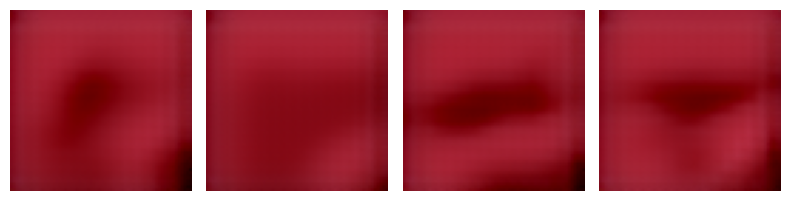

Epoch [2/100], Average Loss: 0.0785


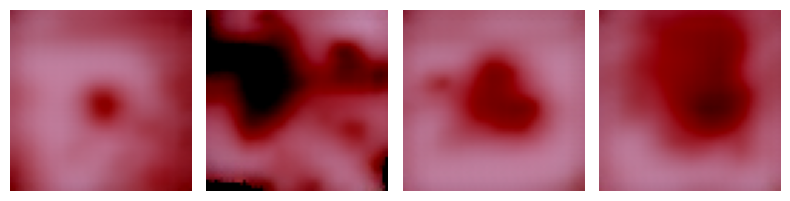

Epoch [3/100], Average Loss: 0.0373


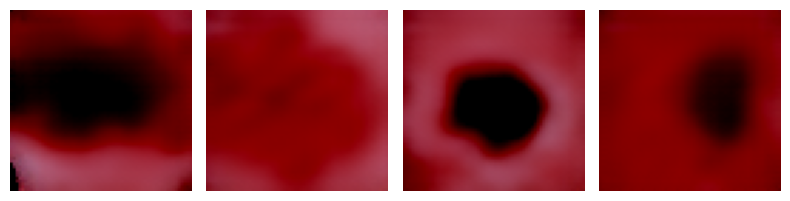

Epoch [4/100], Average Loss: 0.0319


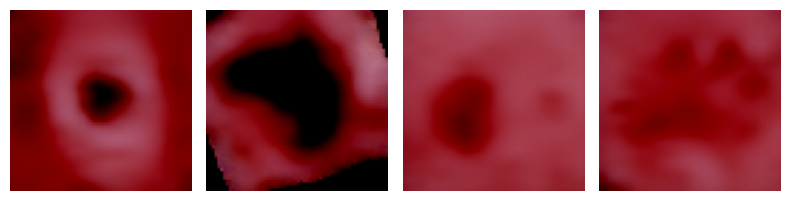

Epoch [5/100], Average Loss: 0.0291


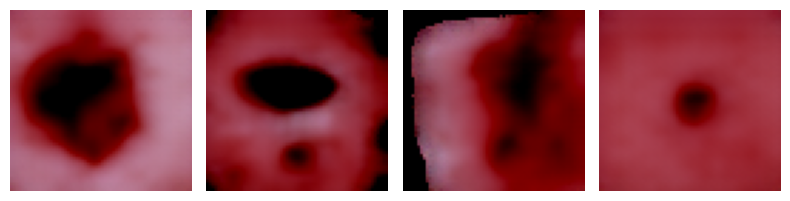

Epoch [6/100], Average Loss: 0.0270


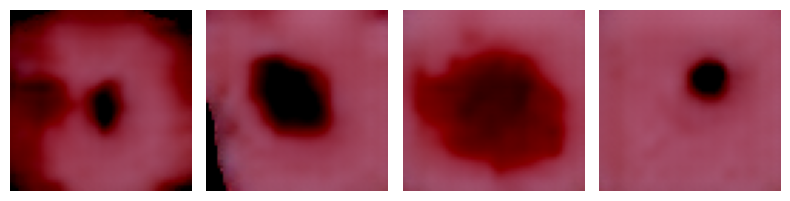

Epoch [7/100], Average Loss: 0.0240


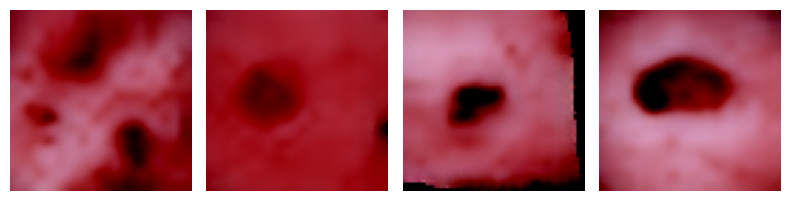

Epoch [8/100], Average Loss: 0.0210


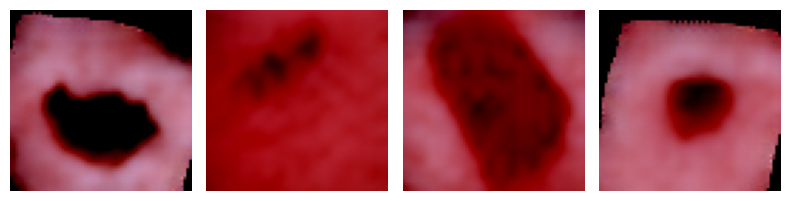

Epoch [9/100], Average Loss: 0.0186


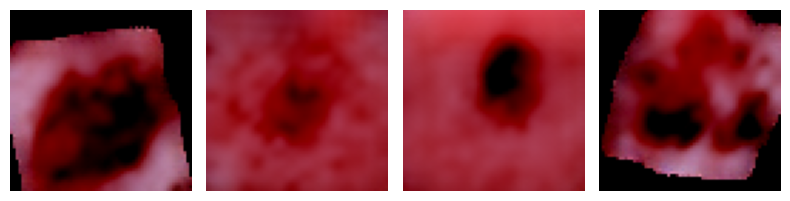

Epoch [10/100], Average Loss: 0.0178


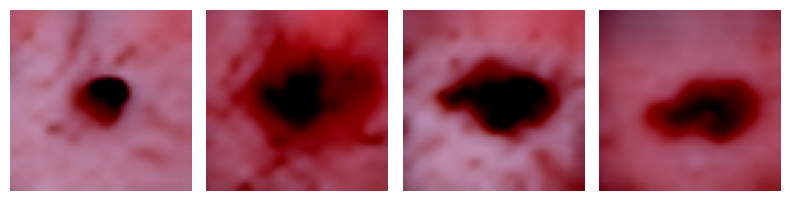

Epoch [11/100], Average Loss: 0.0159


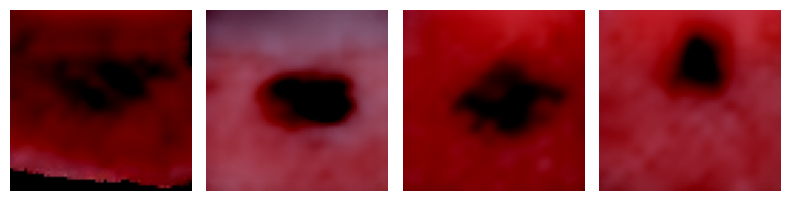

Epoch [12/100], Average Loss: 0.0155


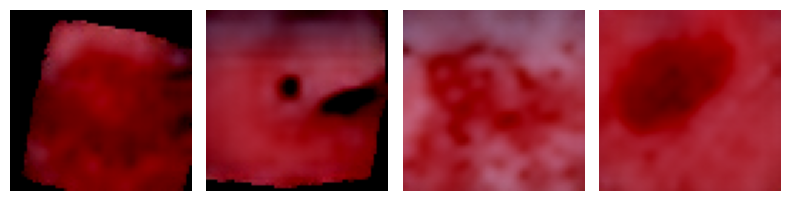

Epoch [13/100], Average Loss: 0.0149


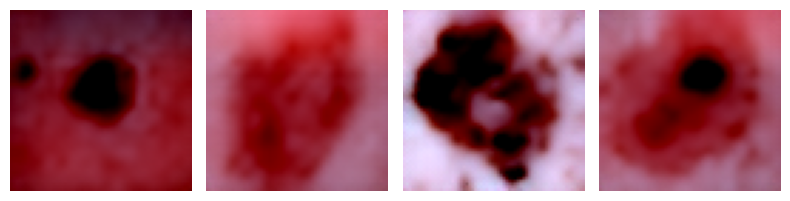

Epoch [14/100], Average Loss: 0.0146


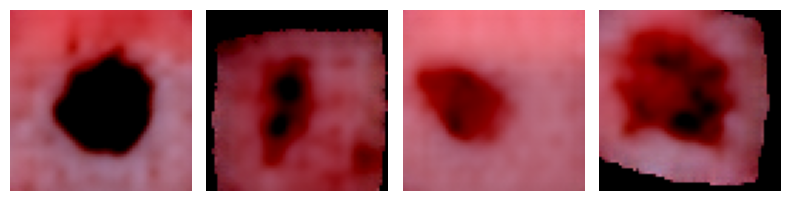

Epoch [15/100], Average Loss: 0.0135


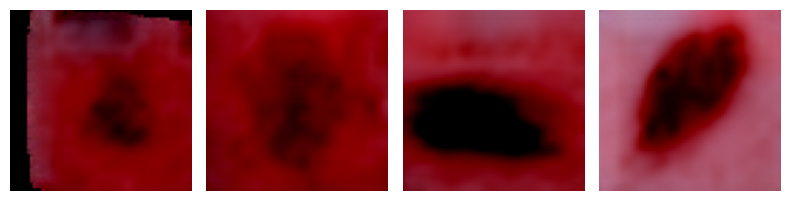

Epoch [16/100], Average Loss: 0.0135


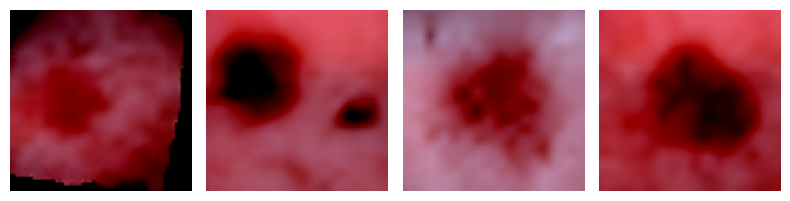

Epoch [17/100], Average Loss: 0.0128


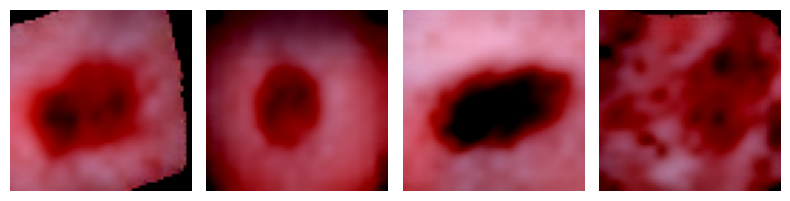

Epoch [18/100], Average Loss: 0.0139


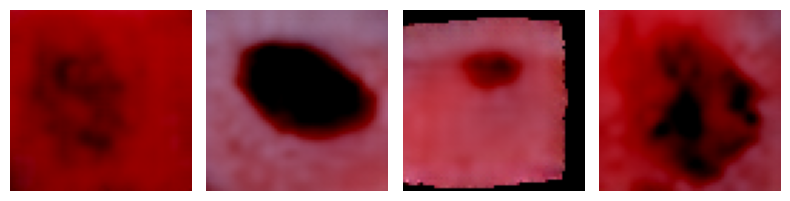

Epoch [19/100], Average Loss: 0.0131


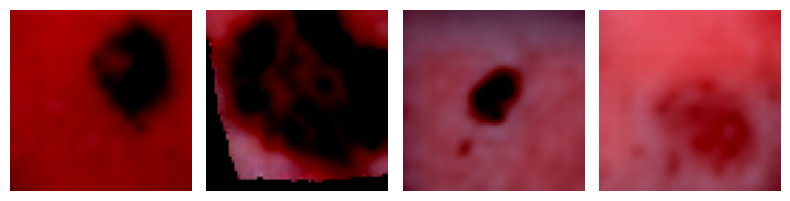

Epoch [20/100], Average Loss: 0.0124


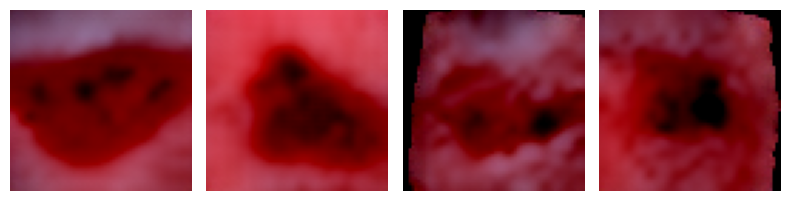

Epoch [21/100], Average Loss: 0.0124


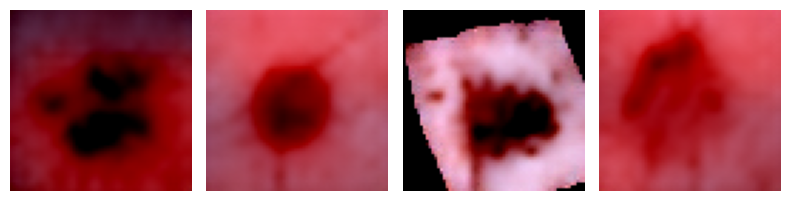

Epoch [22/100], Average Loss: 0.0119


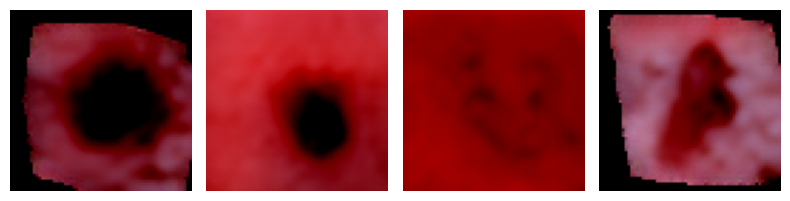

Epoch [23/100], Average Loss: 0.0117


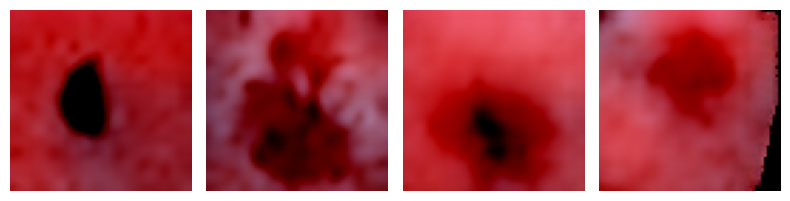

Epoch [24/100], Average Loss: 0.0114


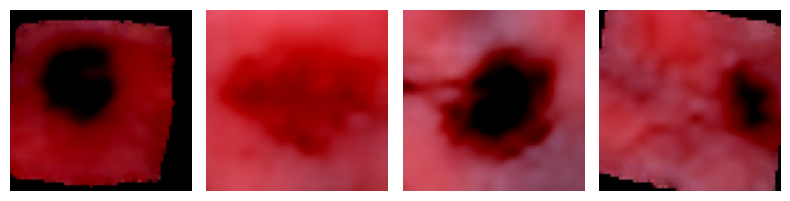

Epoch [25/100], Average Loss: 0.0111


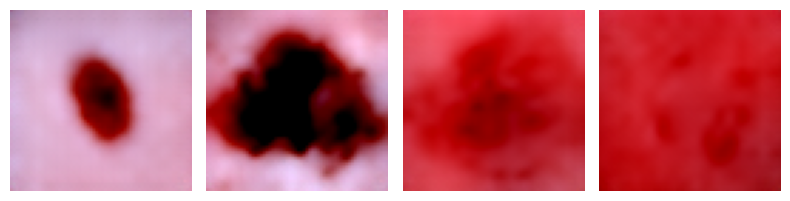

Epoch [26/100], Average Loss: 0.0120


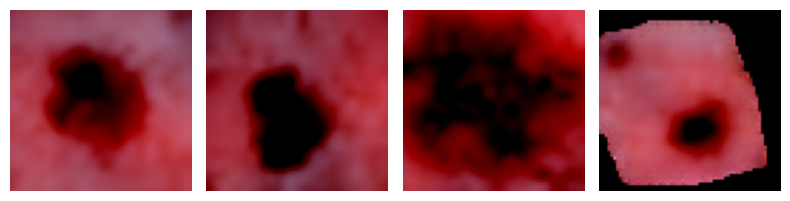

Epoch [27/100], Average Loss: 0.0106


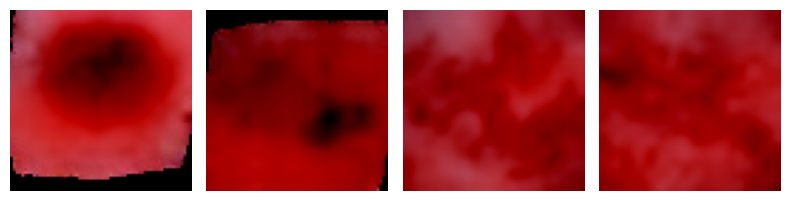

Epoch [28/100], Average Loss: 0.0105


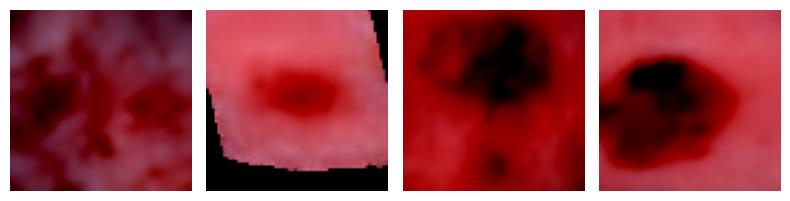

Epoch [29/100], Average Loss: 0.0107


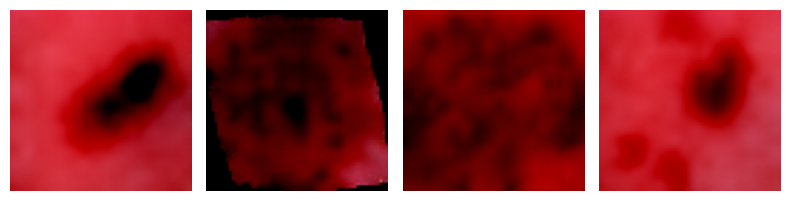

Epoch [30/100], Average Loss: 0.0101


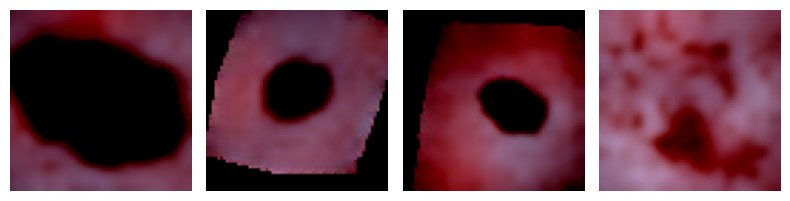

Epoch [31/100], Average Loss: 0.0115


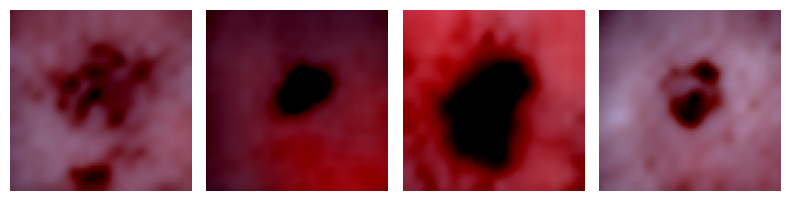

Epoch [32/100], Average Loss: 0.0097


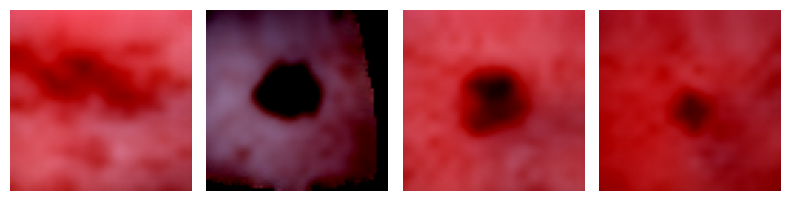

Epoch [33/100], Average Loss: 0.0103


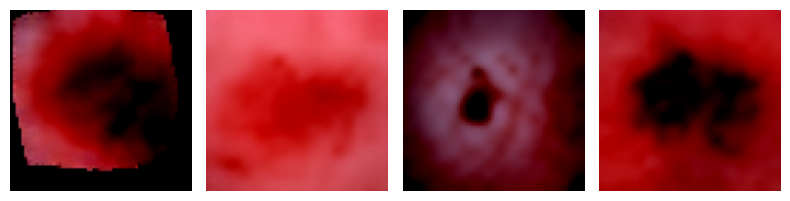

Epoch [34/100], Average Loss: 0.0095


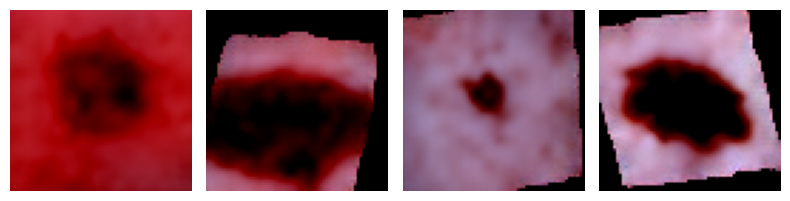

Epoch [35/100], Average Loss: 0.0100


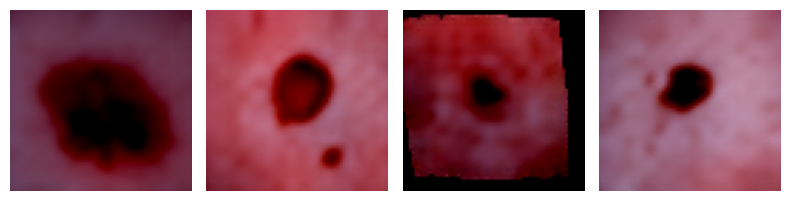

Epoch [36/100], Average Loss: 0.0094


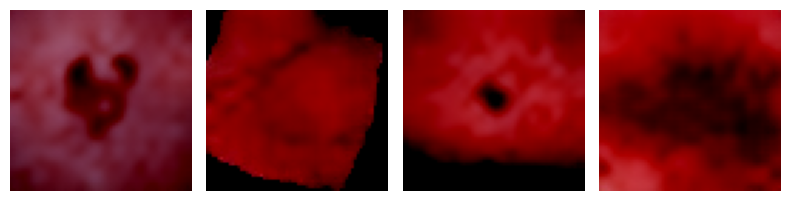

Epoch [37/100], Average Loss: 0.0089


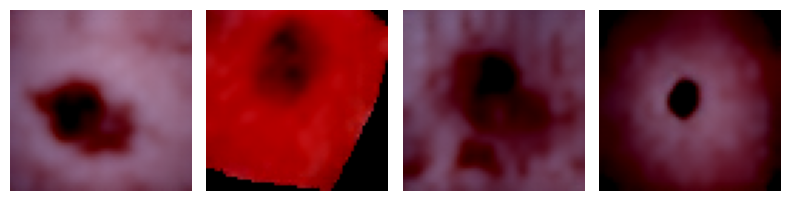

Epoch [38/100], Average Loss: 0.0083


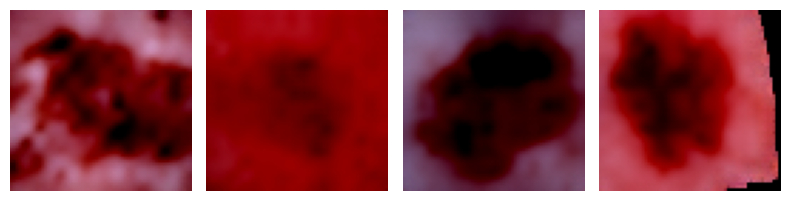

Epoch [39/100], Average Loss: 0.0084


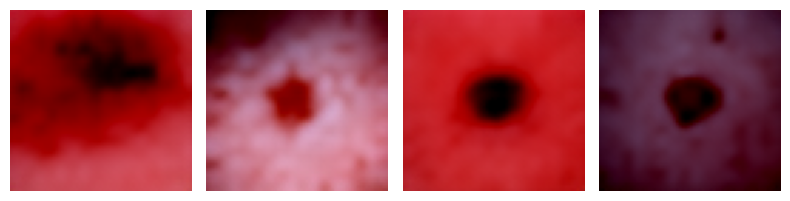

Epoch [40/100], Average Loss: 0.0079


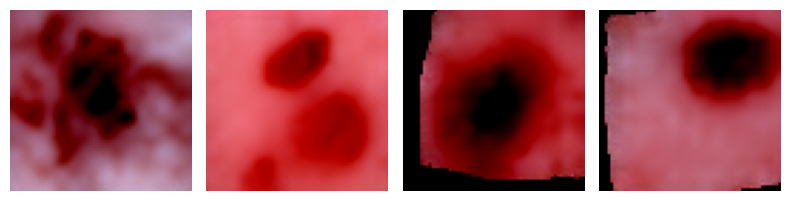

Epoch [41/100], Average Loss: 0.0083


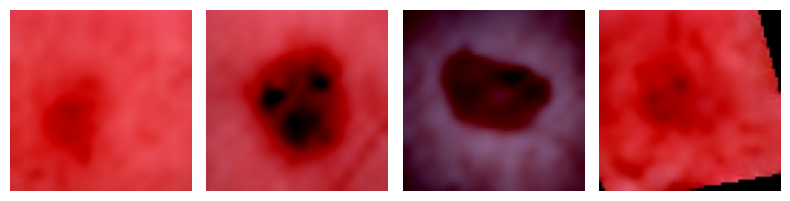

Epoch [42/100], Average Loss: 0.0081


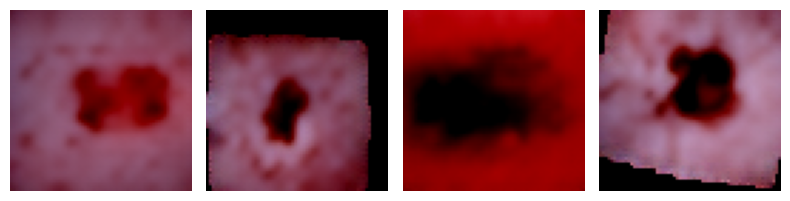

Epoch [43/100], Average Loss: 0.0078


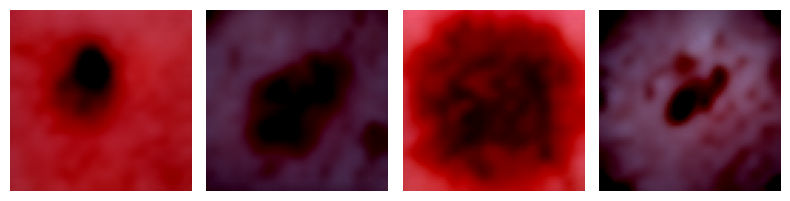

Epoch [44/100], Average Loss: 0.0083


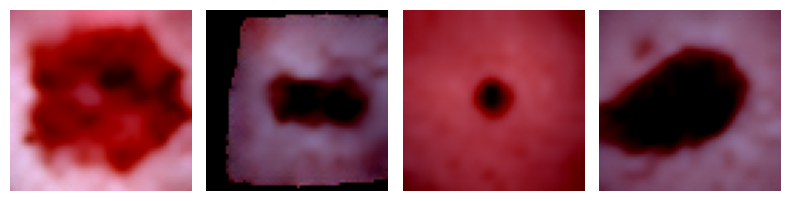

Epoch [45/100], Average Loss: 0.0072


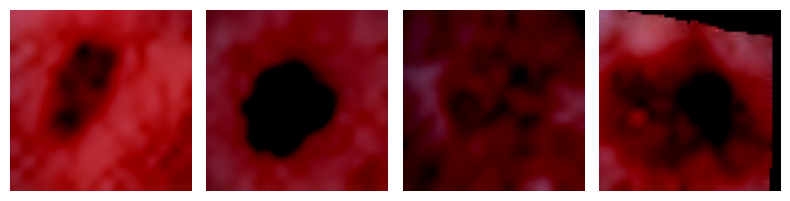

Epoch [46/100], Average Loss: 0.0080


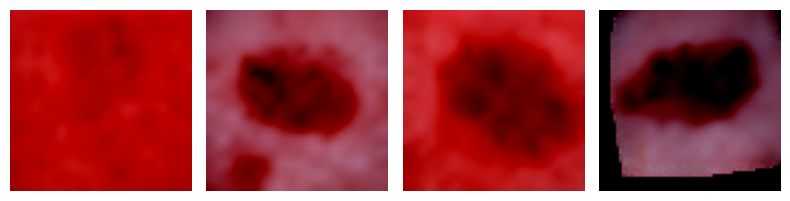

Epoch [47/100], Average Loss: 0.0077


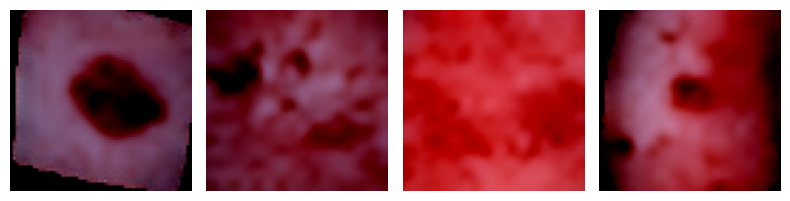

Epoch [48/100], Average Loss: 0.0074


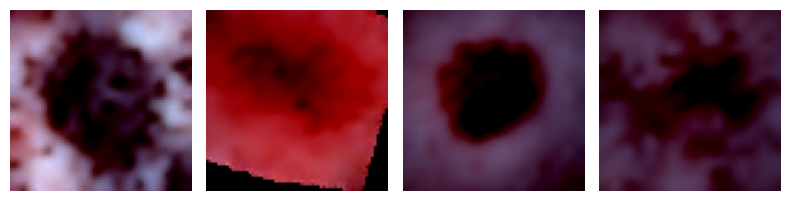

Epoch [49/100], Average Loss: 0.0070


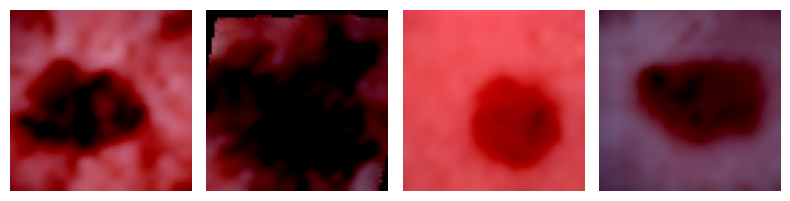

Epoch [50/100], Average Loss: 0.0072


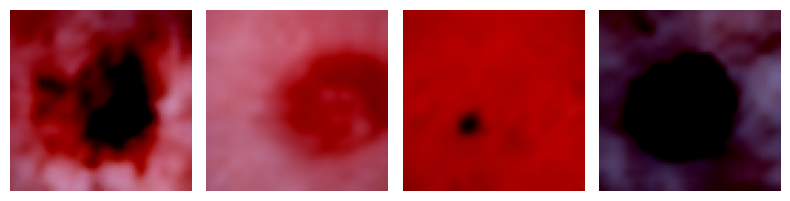

Epoch [51/100], Average Loss: 0.0066


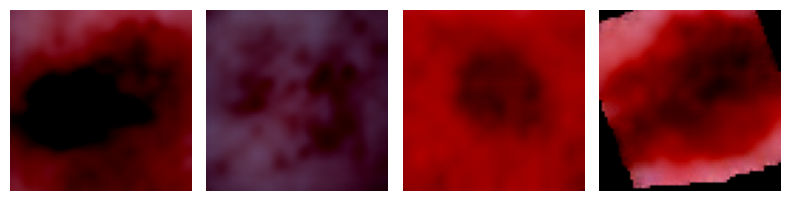

Epoch [52/100], Average Loss: 0.0139


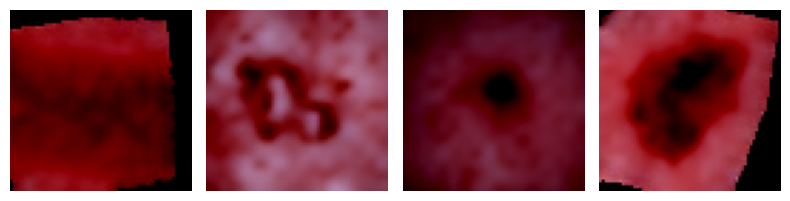

Epoch [53/100], Average Loss: 0.0076


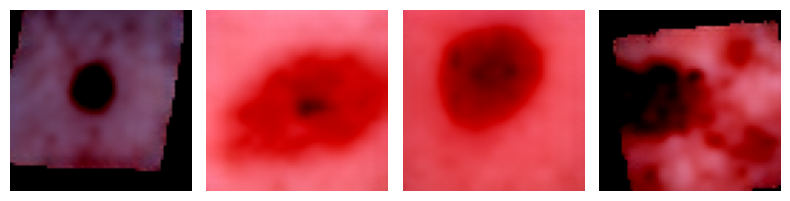

Epoch [54/100], Average Loss: 0.0068


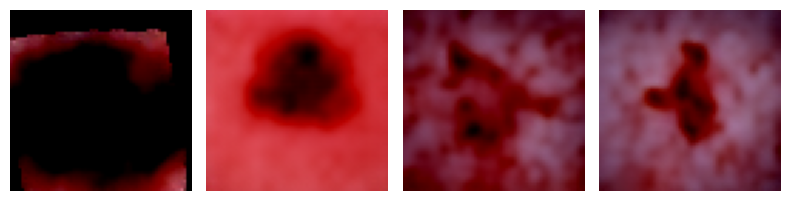

Epoch [55/100], Average Loss: 0.0058


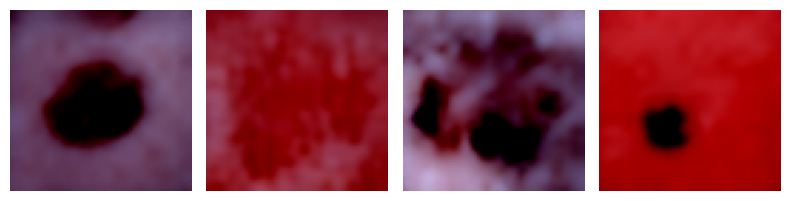

Epoch [56/100], Average Loss: 0.0066


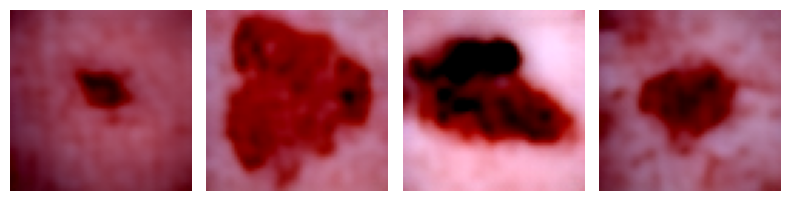

Epoch [57/100], Average Loss: 0.0049


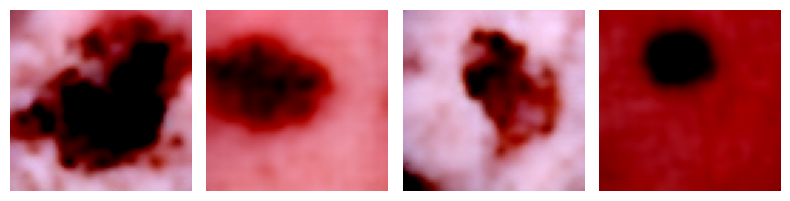

Epoch [58/100], Average Loss: 0.0044


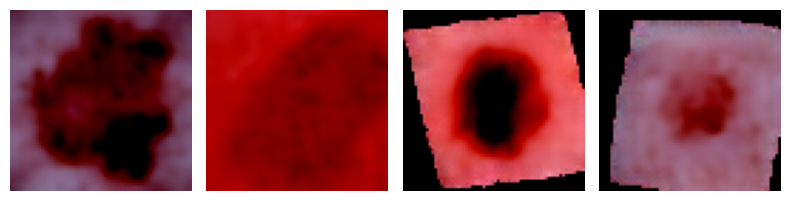

Epoch [59/100], Average Loss: 0.0048


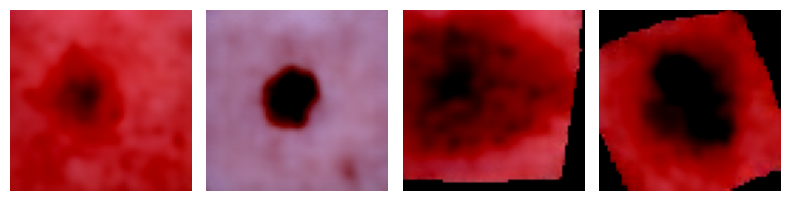

Epoch [60/100], Average Loss: 0.0055


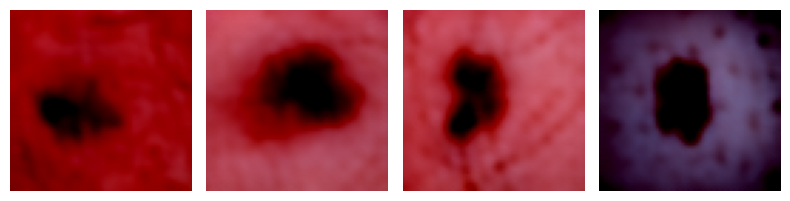

Epoch [61/100], Average Loss: 0.0036


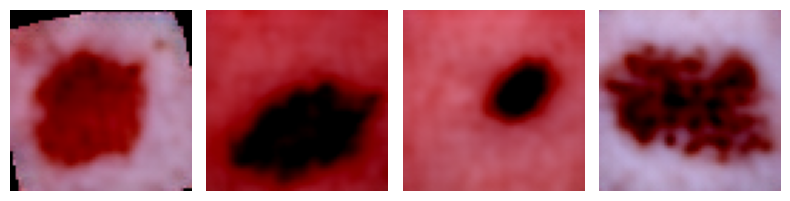

Epoch [62/100], Average Loss: 0.0041


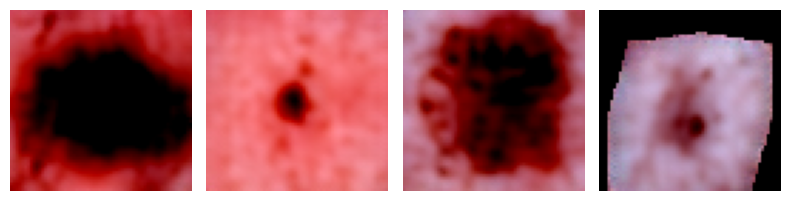

Epoch [63/100], Average Loss: 0.0039


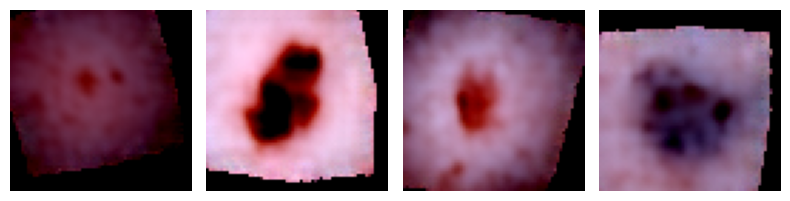

Epoch [64/100], Average Loss: 0.0036


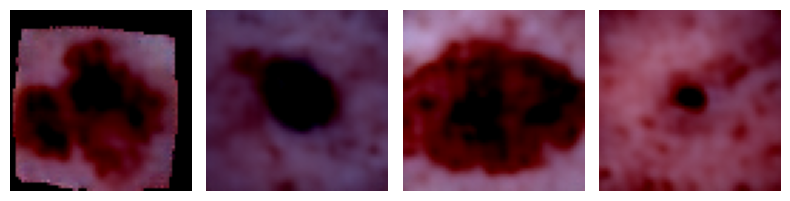

Epoch [65/100], Average Loss: 0.0035


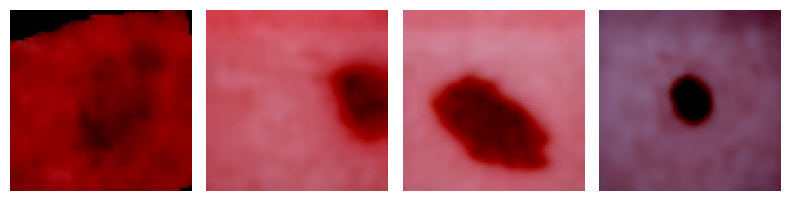

Epoch [66/100], Average Loss: 0.0040


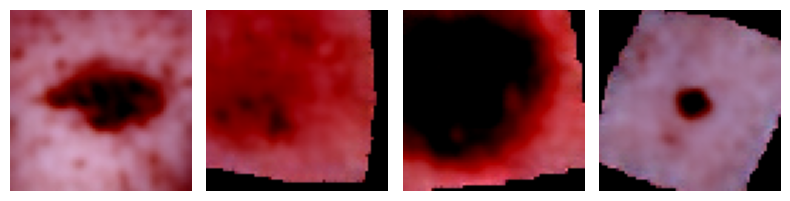

Epoch [67/100], Average Loss: 0.0036


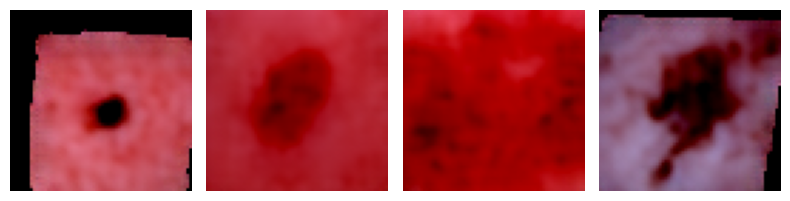

Epoch [68/100], Average Loss: 0.0044


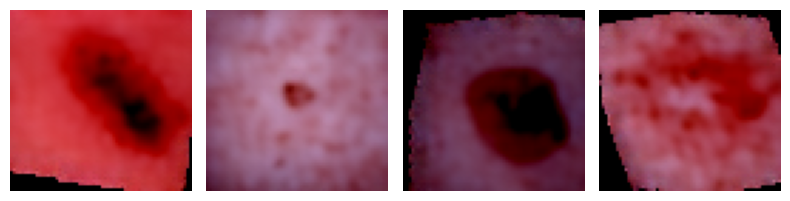

Epoch [69/100], Average Loss: 0.0035


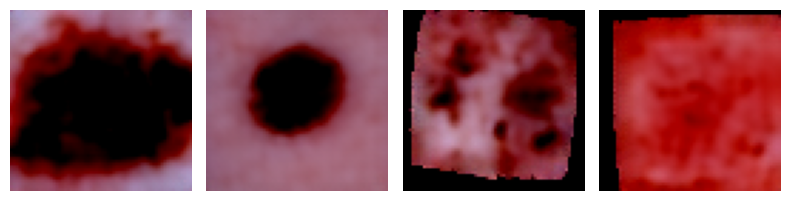

Epoch [70/100], Average Loss: 0.0032


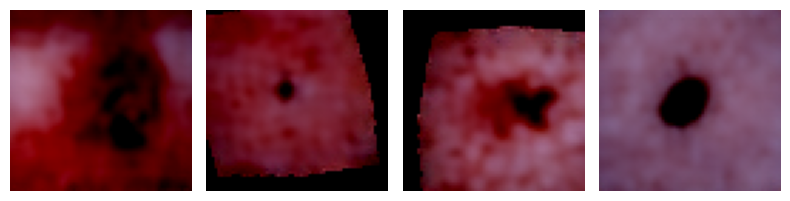

Epoch [71/100], Average Loss: 0.0027


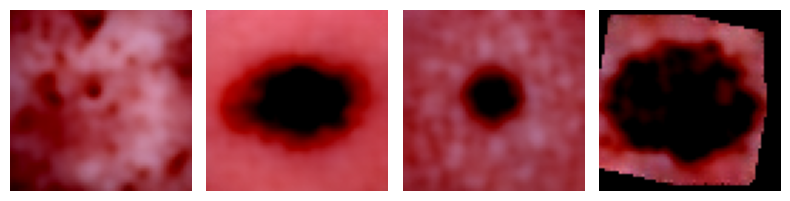

Epoch [72/100], Average Loss: 0.0029


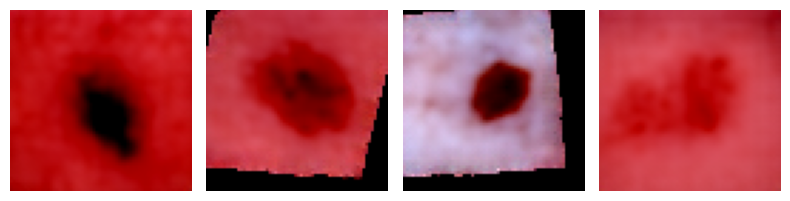

Epoch [73/100], Average Loss: 0.0031


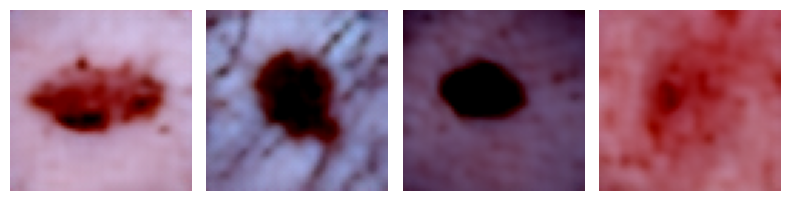

Epoch [74/100], Average Loss: 0.0030


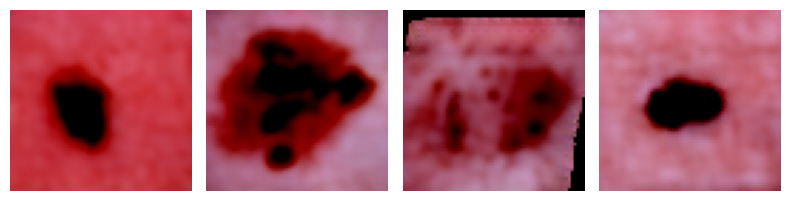

Epoch [75/100], Average Loss: 0.0030


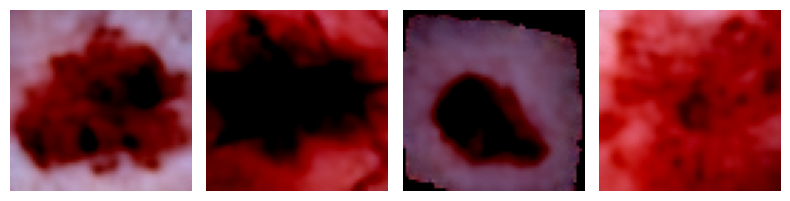

Epoch [76/100], Average Loss: 0.0032


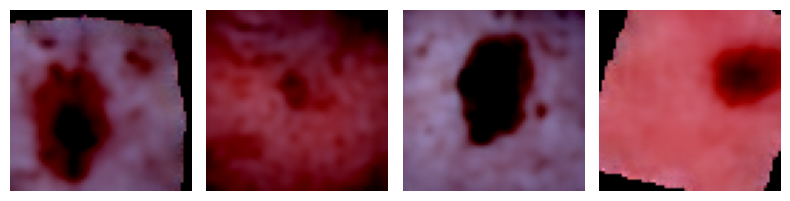

Epoch [77/100], Average Loss: 0.0023


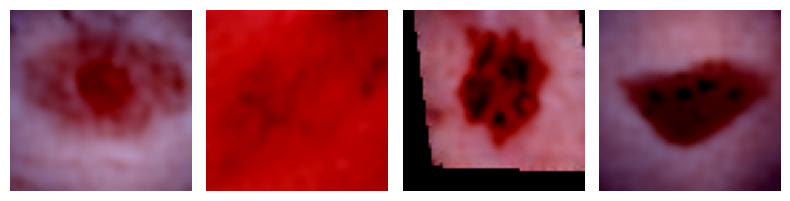

Epoch [78/100], Average Loss: 0.0031


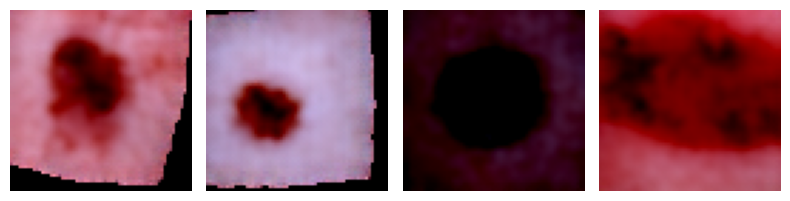

Epoch [79/100], Average Loss: 0.0026


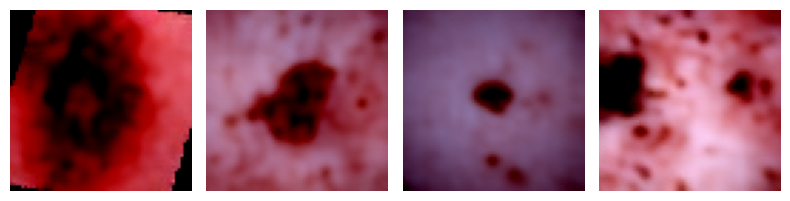

Epoch [80/100], Average Loss: 0.0025


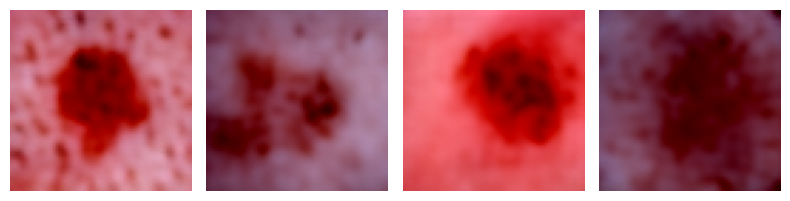

Epoch [81/100], Average Loss: 0.0035


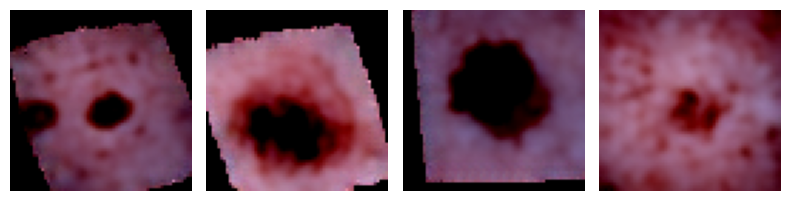

Epoch [82/100], Average Loss: 0.0022


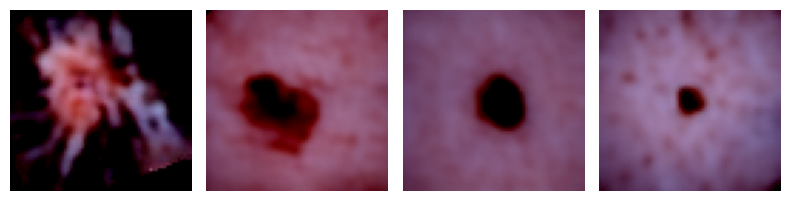

Epoch [83/100], Average Loss: 0.0025


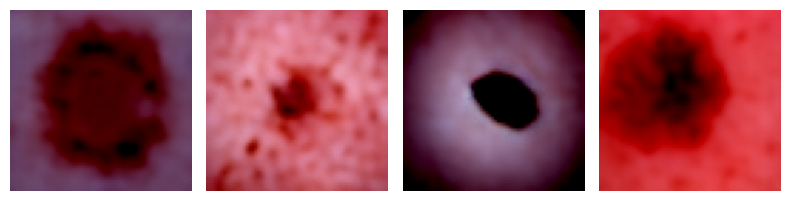

Epoch [84/100], Average Loss: 0.0027


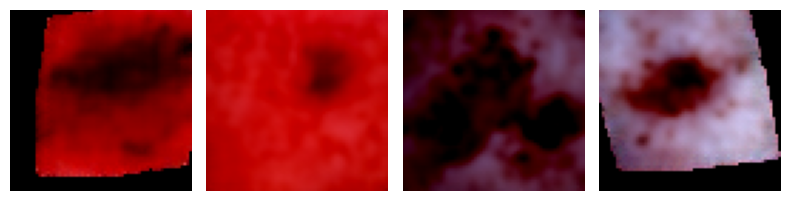

Epoch [85/100], Average Loss: 0.0023


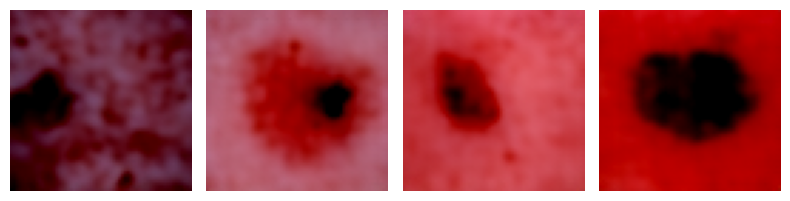

Epoch [86/100], Average Loss: 0.0023


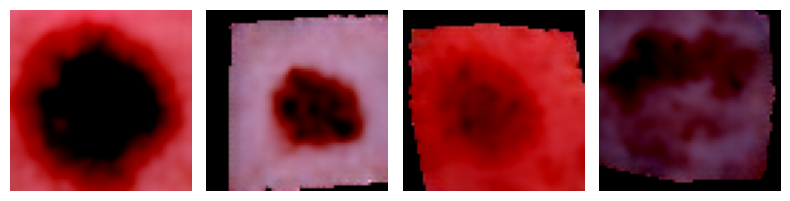

Epoch [87/100], Average Loss: 0.0027


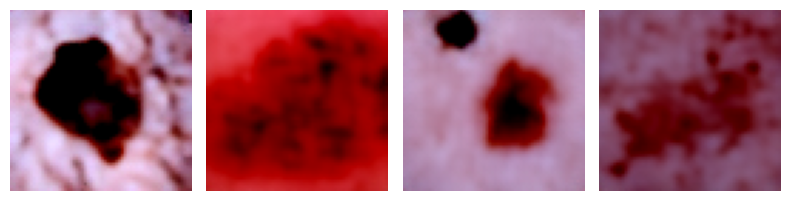

Epoch [88/100], Average Loss: 0.0023


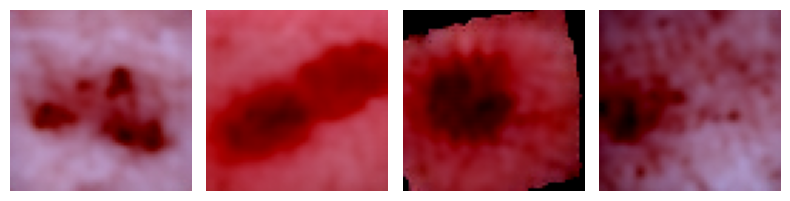

Epoch [89/100], Average Loss: 0.0031


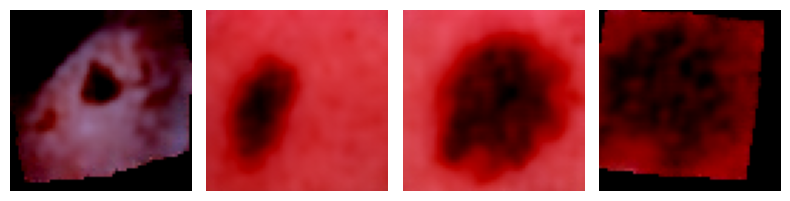

Epoch [90/100], Average Loss: 0.0021


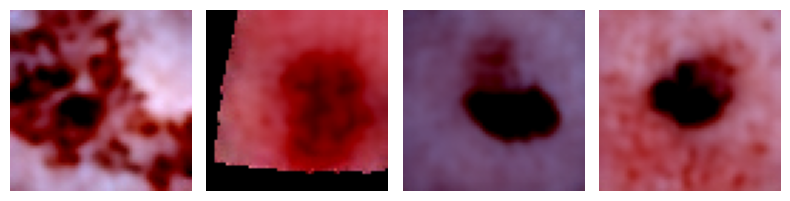

Epoch [91/100], Average Loss: 0.0022


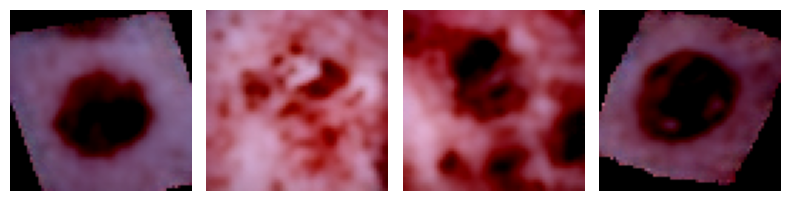

Epoch [92/100], Average Loss: 0.0019


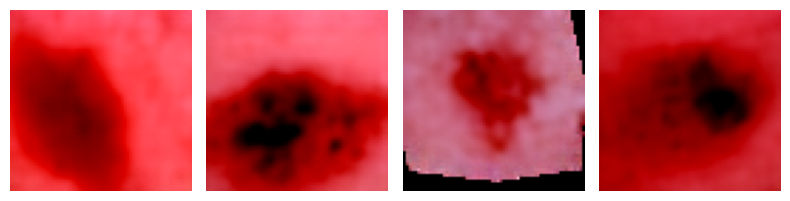

Epoch [93/100], Average Loss: 0.0022


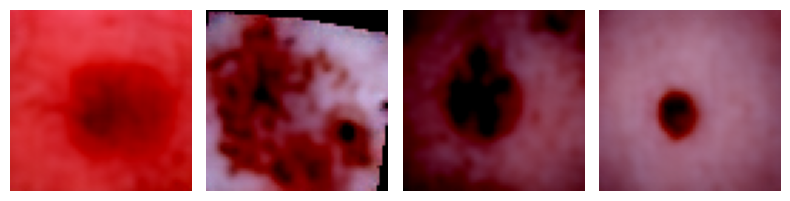

Epoch [94/100], Average Loss: 0.0020


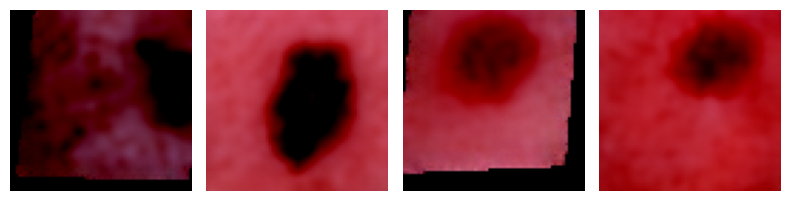

Epoch [95/100], Average Loss: 0.0022


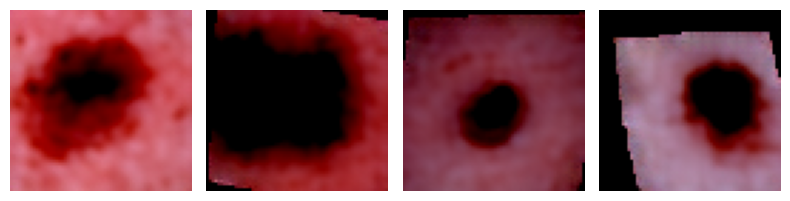

Epoch [96/100], Average Loss: 0.0022


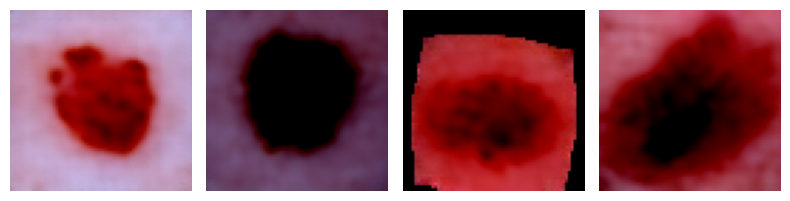

Epoch [97/100], Average Loss: 0.0021


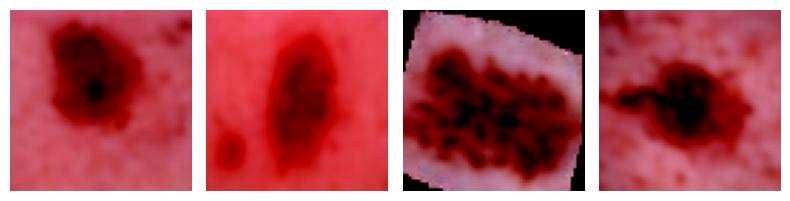

Epoch [98/100], Average Loss: 0.0028


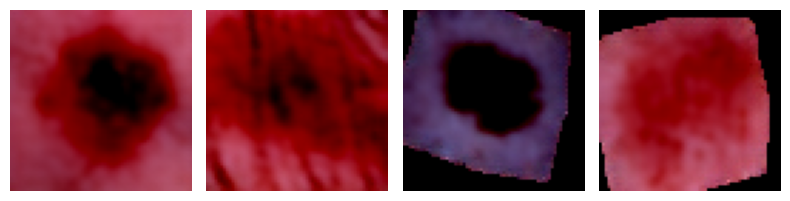

Epoch [99/100], Average Loss: 0.0017


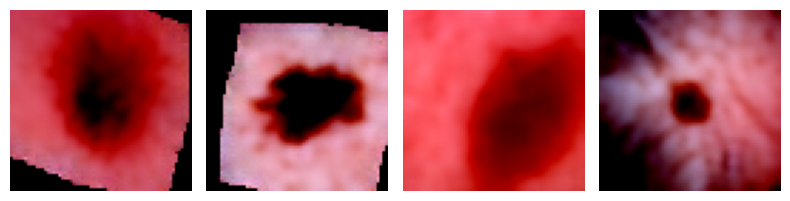

Epoch [100/100], Average Loss: 0.0020


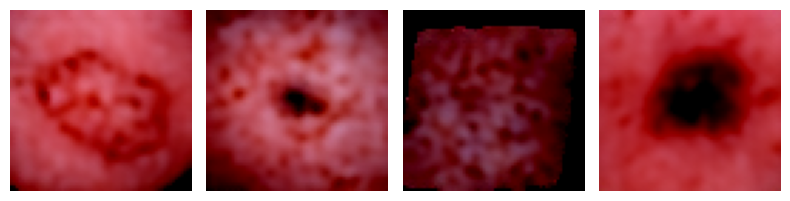

In [135]:
import torch
import torch.optim as optim
import torch.nn as nn

loss_pixel=[]

# Training loop
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
pixel_cnn = PixelCNN().to(device)
#model2 = Model2().to(device)
#model2 = model2.to(device)

# Define optimizer and loss function for PixelCNN
pixel_cnn_optimizer = optim.Adam(pixel_cnn.parameters(), lr=0.01)
pixel_cnn_loss_fn = nn.MSELoss() 

# Freeze parameters of Model2
for param in model2.parameters():
    param.requires_grad = False

# Training loop
num_epochs = 100
for epoch in range(num_epochs):
    pixel_cnn.train()
    total_loss = 0.0
    for inputs in train_loader:
        inputs = inputs.to(device)

        # Pass input through Model2 to get quantized vectors
        with torch.no_grad():
            
            _, out, _,v = model2(inputs)

        # Pass quantized vectors through PixelCNN
        pixel_cnn_optimizer.zero_grad()
        pixel_cnn_output = pixel_cnn(v)

        # Compute loss and perform backpropagation
        loss2 = pixel_cnn_loss_fn(pixel_cnn_output, v)
        loss2.backward()
        pixel_cnn_optimizer.step()

        # Accumulate loss
        total_loss += loss2.item()
       

    # Print average loss for the epoch
    avg_loss = total_loss / len(train_loader)
    loss_pixel.append(avg_loss)
    print(f"Epoch [{epoch+1}/{num_epochs}], Average Loss: {avg_loss:.4f}")
    pixel_cnn.eval()
    
    plt.figure(figsize=(8, 8))

    with torch.no_grad():
        for i, inputs in enumerate(train_loader):
            if i >= 4:  # Plot only 4 images
                break
            inputs = inputs.to(device)
            _, out, _, v = model2(inputs)
            pixel_cnn_output = pixel_cnn(v)
            decoded_output = model2.decode(pixel_cnn_output)

            # Plot each image in a subplot
            plt.subplot(1, 4, i+1)
            plt.imshow(decoded_output[0].permute(1, 2, 0).cpu().numpy())
            plt.axis('off')

    # Show the grid of images
    plt.tight_layout()
    plt.show()

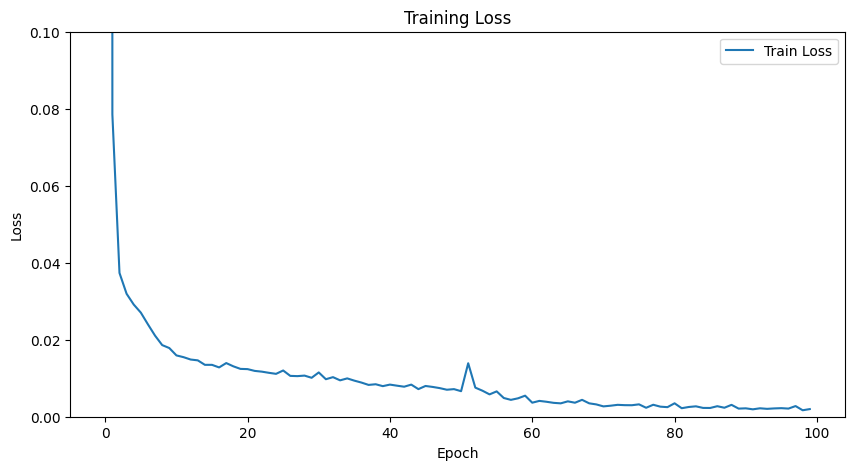

In [140]:
# Plot the training loss
plt.figure(figsize=(10, 5))
plt.plot(loss_pixel, label='Train Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.ylim(0.0, 0.1)
plt.legend()
plt.show()

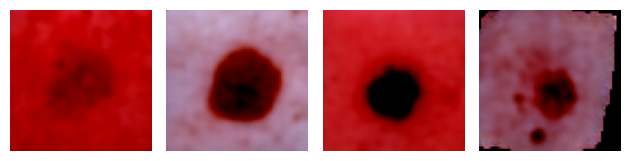

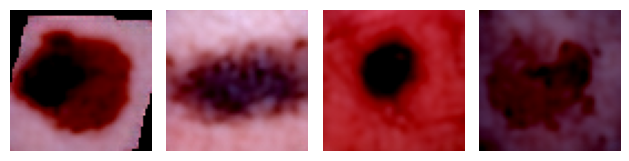

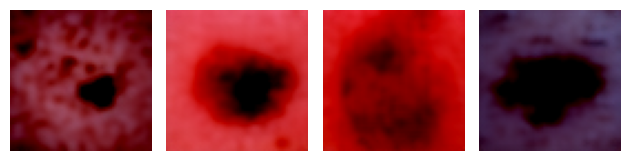

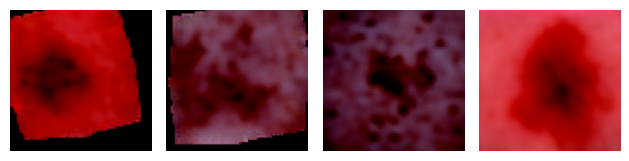

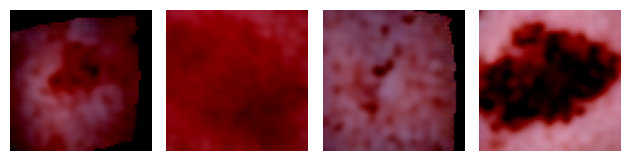

In [137]:

# Run the loop 5 times
for _ in range(5):
    with torch.no_grad():
        for i, inputs in enumerate(test_loader):
            if i >= 4:  # Plot only 4 images
                break
            inputs = inputs.to(device)
            _, out, _, v = model2(inputs)
            pixel_cnn_output = pixel_cnn(v)
            decoded_output = model2.decode(pixel_cnn_output)

            # Plot each image in a subplot
            plt.subplot(1, 4, i+1)
            plt.imshow(decoded_output[0].permute(1, 2, 0).cpu().numpy())
            plt.axis('off')

    # Show the grid of images
    plt.tight_layout()
    plt.show()

torch.Size([1, 3, 64, 64])
torch.Size([1, 3, 64, 64])


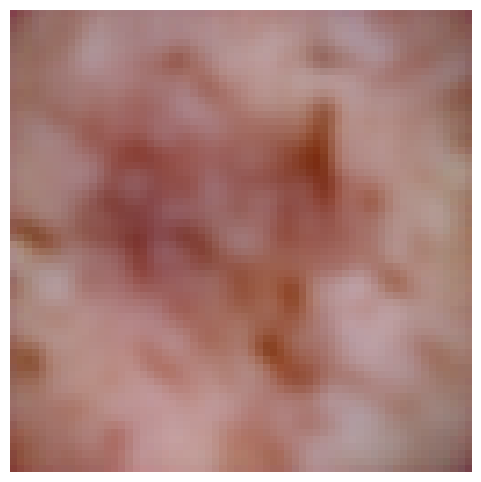

In [146]:
# Load the input image
input_image_path = "/kaggle/input/train/Train_data/ISIC_0024323.jpg"
input_image = Image.open(input_image_path).convert('RGB')

# Define transformations to preprocess the input image
preprocess = transforms.Compose([
    transforms.Resize((64, 64)),  # Resize the image to the required input size
    transforms.ToTensor(),  # Convert image to tensor
])

input_tensor = preprocess(input_image).unsqueeze(0)
print(input_tensor.shape)
input_tensor=input_tensor.to(device)

_, out, _ = model(input_tensor)
print(out.shape)



out = out.squeeze().cpu().detach().numpy()

# Visualize the generated output
plt.figure(figsize=(6, 6))
plt.imshow(np.transpose(out, (1, 2, 0)))
plt.axis('off')
plt.show()


torch.Size([1, 3, 64, 64])
torch.Size([1, 3, 64, 64])


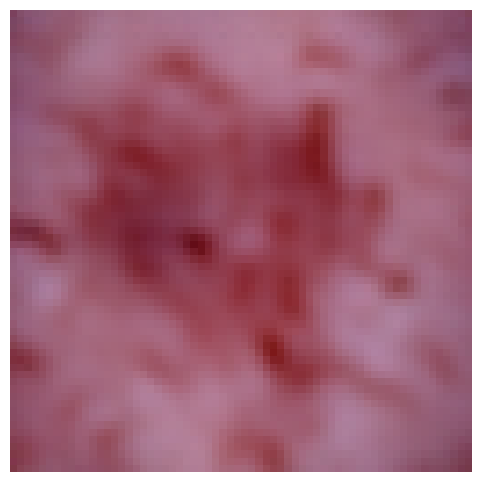

In [145]:
# Load the input image
input_image_path = "/kaggle/input/train/Train_data/ISIC_0024323.jpg"
input_image = Image.open(input_image_path).convert('RGB')

# Define transformations to preprocess the input image
preprocess = transforms.Compose([
    transforms.Resize((64, 64)),  # Resize the image to the required input size
    transforms.ToTensor(),  # Convert image to tensor
])

input_tensor = preprocess(input_image).unsqueeze(0)
print(input_tensor.shape)
input_tensor=input_tensor.to(device)

_, out, _,v = model2(input_tensor)
pixel_cnn_output = pixel_cnn(v)
out = model2.decode(pixel_cnn_output)

print(out.shape)



out = out.squeeze().cpu().detach().numpy()

# Visualize the generated output
plt.figure(figsize=(6, 6))
plt.imshow(np.transpose(out, (1, 2, 0)))
plt.axis('off')
plt.show()
